# Spectral Methods Part II: Chapter 5

Ernesto Barraza-Valdez, June 24, 2024

This notebook follows *Implementing Spectral Methods for Partial Differential Equations* by Dr. David Kopriva.

This is the third of several notebooks that covers Chapters 5 of Dr. Kopriva's textbook.

In this notebook, you are expected to know some Julia and to follow along the book. 
Because Julia has many useful libraries and packages for linear algebra (such as BLAS) and fourier transforms (such as FFTW) we will put those to use in order to focus more on advanced methods for non-periodic problems. 

In [6]:
#Check if Julia is working by checking version
VERSION

v"1.10.3"

We will activate a project in order to keep all Julia Packages useful for the rest of the notebooks

In [7]:
] activate .

  Activating project at `/dfs6/pub/ernestob/Julia/git/Implementing-Spectral-Methods`


If you haven't already created the project from the previous notebook uncomment the next code cell and run it. If the project is already created then you can leave it commented

In [8]:
# ] add BenchmarkTools FFTW Test TimerOutputs HDF5 Printf FastGaussQuadrature ApproxFun FastTransforms Polynomials SpecialPolynomials FastChebInterp Latexify Plots LaTeXStrings IncompleteLU Preconditioners IterativeSolvers LinearMaps RecursiveFactorization LinearOperators Krylov IJulia Revise

In [9]:
using FFTW
using Base.Threads
using LinearAlgebra
using SparseArrays
using Test
using TimerOutputs
using HDF5
using Printf
using FastGaussQuadrature
using ApproxFun
using FastTransforms
using FastChebInterp
using Polynomials
using SpecialPolynomials
using BenchmarkTools
using Latexify
using Plots
using LaTeXStrings
using IncompleteLU
using Preconditioners 
using IterativeSolvers
using LinearMaps
using RecursiveFactorization
using LinearOperators
using Krylov
using IJulia
using Revise

# Creating a Julia Package

We need to create a package in Julia to store all our functions from Chapters 1-4. 

We can follow the following links for `Pkg.jl`: 

https://pkgdocs.julialang.org/v1/creating-packages/

and `Revise.jl`

https://timholy.github.io/Revise.jl/stable/

Where `Revise.jl` makes it easy to revise any of the source code of the package.

First we generate a package with the base package of `Pkg.jl`

Notice that in Jupyter we can use the bracket `]` to access `Pkg` mode

If you have not done this, go ahead and uncomment the below cell

In [10]:
# ] generate Part2a

  Generating  project Part2a:
    Part2a/Project.toml
    Part2a/src/Part2a.jl


A Part I directory was added. Navigating through it we can access the src directory where we will put the Chapter 1-3 code

Next we need to use a terminal app and open Julia. Navigate to this folder.

Activate a project there and add the packages needed for Chapters 1-3. 

Such as the following steps:

```
$> cd ./Part1
$> julia
```

then in Julia

```
] activate .
```
```
] add BenchmarkTools LinearAlgebra SparseArrays FFTW Test TimerOutputs HDF5 Printf FastGaussQuadrature ApproxFun FastTransforms Polynomials SpecialPolynomials FastChebInterp Latexify Plots LaTeXStrings IncompleteLU Preconditioners IterativeSolvers LinearMaps RecursiveFactorization LinearOperators Krylov IJulia
```

After we paste our code from the previous notebook. 

After doing the above we can import the Part1 package. First we need to add it to the scope

In [11]:
push!(LOAD_PATH, "Part2a/");


Then we just use the `using`

In [12]:
using Part2a

[ Info: Precompiling Part2a [9fe5167c-33f7-45a6-bd54-c3f75b7b35d3]


Part 1 and Part 2 Ch 4 functions are now fully loaded

# Ch 5: Spectral Approximation on the Square
------------------

In this Chapter we will take what we learned in Chapter 4 and use it for 2D problems. Much of the examples here are almost exactly the same as Chapter 4 except they are extended to 2D. 

Unfortunately, writing equations in Jupyter notebooks takes a lot of effort and time so please refer to the textbook when needed.

# 5.2: Potential Problems on the Square

Poisson Equation with Dirichlet boundary conditions for the steady state temperature distribution with a heat source:

\begin{align}
    \nabla^2 \varphi &= \varphi_{xx} +\varphi_{yy} = s(x,y) \:\:\:\:\: (x,y) \in (-1,1)\times (-1,1), \\
    \varphi(x,-1) &= 0, \:\:\:\:\:\:  -1 \lt x \lt 1, \\
    \varphi(1,y) &= 0, \:\:\:\:\:\:  -1 \lt y \lt 1, \\
    \varphi(x,1) &= 0, \:\:\:\:\:\:  -1 \lt x \lt 1, \\
    \varphi(-1,y) &= 0, \:\:\:\:\:\:  -1 \lt y \lt 1,
\tag{5.16}
\end{align}

## 5.2.1.1: How to implement Collocation Approximation

We will not need most of these algorithms but will write them out anyways. The reason is that the pseudocode used in the textbook is based off an object-oriented language such as C++. While Julia does have similar capabilities they are different enough that we cannot copy the code and make simple modifications. On the other hand, Julia makes it much easier to manipulate arrays especially for mathematical functions. This is in our favor.

In [231]:
#alg 67
# function MaskSides!(U::Array{Float64}, masks::Array{Bool}, dirboundary::Array{Float64})

#     #assigns boundary to Dirichlet condition
#     #inputs
#     #U - 2D potential (x,y)
#     #masks - boolean array to see which boundaries will be modified [-x, +x, -x, +y]
#     if masks[1] == true
#         @views @. U[:,1] = dirboundary[1]
#     end
#     if masks[2] == true
#         @views @. U[:,end] = dirboundary[2]
#     end
#     if masks[3] == true
#         @views @. U[1,:] = dirboundary[3]
#     end
#     if masks[4] == true
#         @views @. U[end,:] = dirboundary[4]
#     end

#     return nothing

# end

In [232]:
#alg 71
# function Residual!(N::Int64, M::Int64, R::Array{Float64}, LapPhi::Array{Float64}, S::Array{Float64},masks::Array{Bool},dirboundary::Array{Float64})

#     #inputs
#     #N,M - number of nodes minus one for each dimension (x,y)
#     #R - Residual (2D)
#     #LapPhi - Laplacian on the Square for Phi
#     #S - 2D steady state source function
    
#     @. R = 0.0
#     @. R = S - LapPhi # Res = Sij - D^2(Phi)
#     MaskSides!(R, masks, dirboundary)


# end

In [233]:
#alg 66
# function LaplacianOnTheSquare!(U::Array{Float64},ddU::Array{Float64},N::Int64, M::Int64, ddx::Array{Float64}, ddy::Array{Float64})

#     #uses Algorithm 19 (MxVDerivative) which is just matrix-vector multiplication
#     #inputs
#     #U - 2D array of the potential on the grid with indices (x,y)
#     #ddU- 2D array of the d^2 potential on the grid with indices (x,y)
#     #N - total # of grid points in x minus 1
#     #M - total # of grid points in y minus 1
#     #ddx, ddy - 2nd polynomial derivative matrix for x and y

#     for j in 0:M
#         jj=j+1
#         @views @. ddU[:,jj] = ddx*U[:,jj]

#     end
#     for i in 0:N
#         ii=i+1
#         @views @. ddU[ii,:] = ddU[ii,:] + ddy*U[ii,:]

#     end

#     return nothing

# end

## Using Julia's LinearMaps.jl to define Matrix-Free methods

In this section we will use Matrix-Free methods. 

For many problems, the discrete matrix operators become too large and cumbersome to store in memory. Thus, it's easier to use matrix-free operations. An example of this is actually the Algorithms 79-80 where the exact matrix isn't used but instead parts of it used for the calculation of the preconditioning algorithm. 

Likewise, we will attempt to do something similar with the Julia library: LinearMaps.jl

The first example is the poisson equation:

\begin{align}
    \nabla^2 \varphi = s
\end{align}

Which we can write in matrix form using the Second Order Central Difference equatons for descritization:

\begin{align}
    \underline{A}\cdot \bar{\varphi} = \bar{s} 
\end{align}

Below we write a function `SecondOrderCentralDiffmul!(C, B)` that takes in an input vector `B` and outputs a vector `C` so that this function acts as a matrix operation:

\begin{align}
    \underline{A}\cdot \bar{\varphi} = \bar{s}
\end{align}

We will do a Second Order Central Difference estimation of the Poisson equation which you can find in this link:

https://en.wikipedia.org/wiki/Finite_difference#Higher-order_differences

The source term or right-hand-side $\bar{s}$  is usually given by the initial conditions or boundary conditions. So we are concerned with finding $\bar{\varphi}$ 

We can then use either matrix algebra or iterative methods to get the solution $\bar{\varphi}$ 

In [19]:
function SecondOrderCentralDiffmul!(C, B)
    C[1] = -2B[1] + B[2]
    for i in 2:length(B)-1
        C[i] = B[i-1] - 2B[i] + B[i+1]
    end
    C[end] = B[end-1] - 2B[end]
    return C
end

#set up number of points
nnn = 51
#create linear map of the Second Order Central Difference Function
A = LinearMap(SecondOrderCentralDiffmul!, nnn; issymmetric=true, ismutating=true)
#create random input vector
s = rand(nnn)

#use iterative GMRES method from IterativeSolvers.jl obtain solucion C
phi = IterativeSolvers.gmres(A, s,maxiter=10000000)
#check to see that phi is close enough to be a solution
norm(A*phi - s)

6.446394316524368e-8

Which is close enough to zero!

In [235]:
#@btime gmres(A, b,maxiter=10000000);

In [236]:
#@btime xxx = gmres($A, $b,maxiter=10000000);

In [237]:
#@time gmres(A, b,maxiter=10000000);

Now we will try this for our original problem


First we need to an algorithm that spits out our Derivative matrix elements rather than having to store the entire derivative matrix. The following algorithms are re-writes for Algorithms 37 and 38 for the polynomial derivative matrices using the lagrange-barycentric weights to spit out an element of the matrices. 

In [20]:
#Algorithm 37b
function PolynomialDerivativeMatrixElement(x::Array{Float64}, w::Array{Float64},II::Int64,JJ::Int64)
    #need barycentric weights
    N = length(x)-1
    Dij = 0.0
    #w = BarycentricWeights(x)
    # D = zeros(Float64, (N+1,N+1))
    if II!=JJ 
        Dij = w[JJ+1]/w[II+1] /(x[II+1] - x[JJ+1])

    elseif II==JJ
        # for i in 0:N
        #     ii = i+1
        #     Dij = 0.0
        for j in 0:N
            jj=j+1
            if j != II
                # D[ii,jj] = w[jj]/w[ii] /(x[ii] - x[jj])
                # D[ii,ii] = D[ii,ii] - D[ii,jj] #+ 1/(x[jj] - x[ii]) #
                Dij = Dij -  w[jj]/w[II+1] /(x[II+1] - x[jj])
            end
        end
    
        # end
    end
    return Dij

end

#algorithm 38b
function mthPolynomialDerivativeMatrixElement(m::Int64,x::Array{Float64},w::Array{Float64}, II::Int64,JJ::Int64)
    #need barycentric weights
    N = length(x)-1
    #Dij = 0.0
    #w = BarycentricWeights(x)
    # D = zeros(Float64, (N+1,N+1))
    mDij = [ PolynomialDerivativeMatrixElement(x, w,II,jjj) for jjj in 0:N]
    #Dii = [ PolynomialDerivativeMatrixElement(x, w,jjj,jjj) for jjj in 0:N]
    Dij = zeros(Float64,N+1)
    #mDii = zeros(Float64,N+1)

    if m==1
        return Dij
    else
        for mm in 2:m
            @. Dij = mDij #copy at start of loop so it will end when derivative is calculated rather than copy
            for j in 0:N
                jj=j+1
                if jj!=II+1 #exclude when i=j
                    mDij[jj] = mm/(x[II+1]-x[jj])*(w[jj]/w[II+1]*Dij[II+1] -Dij[jj])
                end
            end
            #calculate diagonal
            mDij[II+1] = -1.0 * sum(mDij[1:end .!=(II+1)])
            #
        end
        
    end
    
    
    return mDij[JJ+1]

end

mthPolynomialDerivativeMatrixElement (generic function with 1 method)

Let's double check that our new code matches the original Algorithms 37 and 38

In [21]:
nn =24
NN = nn
MM = nn
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
wb = BarycentricWeights(xyleg);


In [22]:
#Dx, DDx, Dy, DDy =  NodalPotentialConstruct(xyleg,xyleg, wleg);

In [23]:
i = 12
j = 11
#Dx[i,j]

11

In [24]:
PolynomialDerivativeMatrix(xyleg)[i,j]

-7.846854954696446

In [25]:
PolynomialDerivativeMatrixElement(xyleg,wb, i-1,j-1)

-7.846854954696446

In [26]:
mthOrderPolynomialDerivativeMatrix(2, xyleg)[i,j]#*mthOrderPolynomialDerivativeMatrix(1, xyleg)[10,11]

124.69575804965429

In [27]:
mthPolynomialDerivativeMatrixElement(2,xyleg,wb, i-1,j-1)

124.69575804965429

### Back to Original Text

In [42]:
#alg 64
#ch 5.2.1.1 pg 155
# Function to construct necessary variables for 2D 
function NodalPotentialConstruct(x::Array{Float64},y::Array{Float64}, ww::Array{Float64})

    #uses Algorithm 38 (mthOrderPolynomialDerivativeMatrix)
    #inputs
    #xy - 2D lobatto points of grid, first index  is x-coordinates, second is y-coord
    #ww - 2D weights of lobatto points

    # N = lengt(x[:,1])-1
    # M = lengt(y[1,:])-1
    N = length(x)-1
    M = length(y)-1
    
    # Dx = mthOrderPolynomialDerivativeMatrix(1, xy[:,1])
    # DDx = mthOrderPolynomialDerivativeMatrix(2, xy[:,1])
    # Dy = mthOrderPolynomialDerivativeMatrix(1, xy[1,:])
    # DDy = mthOrderPolynomialDerivativeMatrix(1, xy[1,:])
    Dx = mthOrderPolynomialDerivativeMatrix(1, x)
    DDx = mthOrderPolynomialDerivativeMatrix(2, x)
    Dy = mthOrderPolynomialDerivativeMatrix(1, y)
    DDy = mthOrderPolynomialDerivativeMatrix(1, y)

    return Dx, DDx, Dy, DDy

end

NodalPotentialConstruct (generic function with 1 method)

We now want to re-write Algorithm 66 in the form of a linear map (matrix free method) so that the derivative matrices don't need to be stored. We follow **Eqn 5.22**. **Eqn 5.24** is the boundary conditions and tells us that the discretized $\partial_{xx} \Phi$ will give zeros for the boundaries. So we set the boundary values of $\left. \partial_{xx} \Phi \right|_{boundaries} = 0$

**Note** that because the Laplace Operator for this section requires a lot of input variables we need to use **Anonymous Functions** which you can read more about here:

https://docs.julialang.org/en/v1/manual/functions/

In [53]:
#Alg 66
#ch 5.2.1.1 pg 156
# Anonymous Function for Collocation Laplace Operator
#will be initialized after inputs x,y,wbx, wby are created
#Note that this operators works on a 1D Vector so any 2D vector must be flattened to 1D
CollocationLapOp = (x::Array{Float64}, y::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64}) -> LinearMap((length(x))*(length(y)); ismutating=true) do dPhi,Phi

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. dPhi = 0.0
    #println(length(dPhi))

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            for k in 0:N #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1)
                dPhi[nn] = dPhi[nn] + mthPolynomialDerivativeMatrixElement(2,x,wbx, i,k)*Phi[nx]
            end
            for k in 0:M #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                dPhi[nn] = dPhi[nn] + mthPolynomialDerivativeMatrixElement(2,y,wby, j,k)*Phi[ny]
                #dPhi[nn] = dPhi[nn] + PolynomialDerivativeMatrixElement(y, j,k)*PolynomialDerivativeMatrixElement(y, j,k)*Phi[ny]
            end

        end
    end


    return dPhi


end

#27 (generic function with 1 method)

In [248]:
#alg 68 nothing important

### 5.2.1.3: Direct Solution of Equations

In [52]:
#alg 69
#ch 5.2.1.3 pg 160
#RHS construction of equation
#This function creates a 1D Vector of the RHS from a 2D input
function CollocationRHSComputation!(N::Int64, M::Int64, Phi::Array{Float64},RHS::Array{Float64},S::Array{Float64}, Dx::Array{Float64},Dy::Array{Float64})

    #inputs
    #N,M - number of nodes minus one for each dimension (x,y)
    #Phi - current potential (2D)
    #RHS - Flattened vector of size L = (N-1)*(M-1)
    #S - 2D steady state source function
    #Dx,Dy - polynomial derivative matrix in x,y direction
    
    L = (N-1)*(M-1)
    #RHS = zeros(Float64, L+1)
    jj = zero(Int64)
    ii = zero(Int64)
    nn = zero(Int64)

    for j in 1:(M-1)
        jj=j+1
        for i in 1:(N-1)
            ii = i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            RHS[nn] = S[ii,jj] - Dx[ii, 0+1]*Phi[0+1,jj] - Dx[ii,N+1]*Phi[N+1,jj] - Dy[jj,0+1]*Phi[ii,0+1] - Dy[jj,M+1]*Phi[ii,M+1]

        end
    end

    return nothing

end

CollocationRHSComputation! (generic function with 1 method)

In [34]:
#alg 70 
#ch 5.2.1.3 pg 161
#Direct Matrix Construction of Laplace Operator
function LaplaceCollocationMatrix!(N::Int64, M::Int64, A::Array{Float64}, Dx::Array{Float64},Dy::Array{Float64})
    #inputs
    #N,M - number of nodes minus one for each dimension (x,y)
    #A - LHS matrix (2D) for A*Phi = RHS with size LxL
    #Dx,Dy - polynomial derivative matrix in x,y direction

    L = (N-1)*(M-1)
    @. A = 0.0
    nn = zero(Int64)
    mm = zero(Int64)

    for j in 1:M-1
        jj = j+1
        for i in 1:N-1
            ii = i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            for k in 0:N#1:N-1
                kk = k+1
                mm = kk + (jj-1)*(N+1) #columnwise/fortran
                # mm = j + (i-1)*(M-1) #rowwise/c
                A[nn,mm] = Dx[ii,kk]
            end
            for k in 0:M#1:M-1
                kk=k+1
                mm = ii + (kk-1)*(N+1) #columnwise/fortran
                # mm = j + (i-1)*(M-1) #rowwise/c
                A[nn,mm] = A[nn,mm] + Dy[jj,kk]
            end

        end
    end
    #boundary conditions
    @. A[1,:] = 0.0
    @. A[end,:] = 0.0
    @. A[:,1] = 0.0
    @. A[:,end] = 0.0

    return nothing

    
end

LaplaceCollocationMatrix! (generic function with 1 method)

### 5.2.1.5 A Finite Difference Pre-Conditioner and Matrix-Free Method for Iterative Solvers

Iterative solvers find the closest solution of:

\begin{align}
    \underline{A}\cdot \bar{x} = \bar{b}
\end{align}

by getting closer to the solution each iteration ($k$) via:

\begin{align}
    \bar{x}^{k+1} = \bar{x}^k + \omega^k \bar{v}^k
\tag{D.12}
\end{align}

Where the simplest choice for $\bar{v}$ is:

\begin{align}
    \bar{v}^k = \bar{r}^k = \bar{b} - \underline{A}\cdot\bar{x}^k
\tag{D.13}
\end{align}

Where $\bar{r}$ is the residual and $\omega$ is the step parameter. 



We can use a preconditioner to accelerate the convergence to the solution with a preconditioner $\underline{H}$ so that:

\begin{align}
    \bar{x}^{k+1} = \bar{x}^k + \omega^k \underline{H}^{-1} \bar{v}^k
\tag{D.12}
\end{align}

If we again set $\bar{v} = \bar{r}$ as in **Eq. D.13** then:

\begin{align}
    \underline{H}^{-1} \bar{v}^k &= \underline{H}^{-1} \bar{r}^k \\
    \bar{z} &= \underline{H}^{-1} \bar{r}^k \\
    &\Rightarrow \underline{H} \bar{z} = \bar{r}^k
\end{align}

So the preconditioner makes us solve for  $\bar{z}$

We will do the finite difference preconditioner given in **Eqn 5.37** & **Eqn 5.38**

**NOTE:** We will again use an **Anonymous Function** because of the varying inputs

In [36]:
#eqn 5.37 & 5.38
#pg 163
Aij(dxi::Float64, dxip1::Float64,dyj::Float64, dyjp1::Float64) = -2*(1/(dxi*dxip1) + 1/(dyj*dyjp1))
Bij(dxi::Float64, dxip1::Float64) = 2*1/(dxi*(dxi+dxip1))
Cij(dyj::Float64, dyjp1::Float64) = 2*1/(dyj*(dyj+dyjp1))
Eij(dxi::Float64, dxip1::Float64) = 2*1/(dxip1*(dxi+dxip1))
Fij(dyj::Float64, dyjp1::Float64) = 2*1/(dyjp1*(dyj+dyjp1))

#Alg 72 & Alg 73
#Ch 5.2.1.5 pg 166
#Anonymous Function for Finite Difference Preconditioner
FDPreconditionerMul = (x::Array{Float64}, y::Array{Float64}) -> LinearMap((length(x))*(length(y)); ismutating=true) do Z,U

    N = length(x) - 1
    M = length(y) - 1
    @. Z = 0.0

    for j in 1:M-1
        jj = j+1
        for i in 1:N-1
            ii = i+1
            nn = ii + (jj-1)*(N+1)
            nnim1 = ii-1 + (jj-1)*(N+1)
            nnjm1 = ii + (jj-1-1)*(N+1)
            nnip1 = ii+1 + (jj-1)*(N+1)
            nnjp1 = ii + (jj-1+1)*(N+1)
            
            Z[nn] = Aij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii]), (y[jj]-y[jj-1]), (y[jj+1]-y[jj]) ) * U[nn] + Bij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii]) ) * U[nnim1] +  Cij( (y[jj]-y[jj-1]), (y[jj+1]-y[jj]) ) * U[nnjm1] + Eij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii])  ) * U[nnip1] + Fij( (y[jj]-y[jj-1]), (y[jj+1]-y[jj])  ) * U[nnjp1]

        end
    end

    return Z
    

end

#19 (generic function with 1 method)

### 5.2.1.6 How to Construct the Iterative Potential Solver

We skip this section because Julia  has many libraries/packages that can be used for iterative solvers such as `IterativeSolvers.jl` and `Krylov.jl`

### 5.2.1.7 Benchmark Solution

We will benchmark **Eqn 5.56**

We will use the Julia's IterativeSolvers.jl for the BicSTABl

In [39]:
nn = 32
NN = nn
MM = nn
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
wb = BarycentricWeights(xyleg)

Fsource(x,y) = -8.0*pi^2*cos(2.0*pi*x)*sin(2.0*pi*y);

In [40]:
#create source matrix
Sij = [Fsource(i,j) for i in xyleg, j in xyleg];
#create Phi with dirichlet boundary conditions
p0 = zeros(Float64, (nn+1,nn+1))
@. p0[:,1] = 0.0 #Phi(x,-1) = 0.0
@. p0[end,:] = sin(2.0*pi*xyleg)
@. p0[:,end] = 0.0 #Phi(x,1) = 0.0
@. p0[1,:] = sin(2.0*pi*xyleg);
p1= deepcopy(p0);

After creating our 2D functions we need to flatten them and get a RHS. This is done by `CollocationRHSComputation!`

In [43]:
#construct derivative matrices for the RHS 
Dx, DDx, Dy, DDy =  NodalPotentialConstruct(xyleg,xyleg, wleg)
RHS = zeros(Float64, ((NN+1)*(MM+1)))
CollocationRHSComputation!(NN, MM, p1,RHS,Sij, DDx,DDy);

In [51]:
size(RHS)

(1089,)

In [44]:
#Set up Laplace Operator
LOp = CollocationLapOp(xyleg, xyleg, wb,wb)
#set up Finite Difference Preconditioner
FDpre = FDPreconditionerMul(xyleg,xyleg)

1089×1089 FunctionMap{Float64,true}(#20; issymmetric=false, ishermitian=false, isposdef=false)

To use the `IterativeSolvers.jl` functions, we need to define an operator along with its inverse since we are looking to find the solution to a matrix equation. To do this we use Julia's `struct` and define it's operation.

In [45]:
#Need to define a preconditioner struct
struct PreCond{A}
	fun::A

end


In [46]:
PC = PreCond(FDpre)

PreCond{FunctionMap{Float64, var"#20#22"{Vector{Float64}, Vector{Float64}}, Nothing, true}}(1089×1089 FunctionMap{Float64,true}(#20; issymmetric=false, ishermitian=false, isposdef=false))

Julia allows for **Multiple Dispatch** which means we can define multiple arguments and outputs for the same function. `IterativeSolvers.jl` requires we define an inverse of our operator. We can define this by "overloading" the `LinearAlgebra.ldiv!` via multiple dispatch. 

We define `LinearAlgebra.ldiv!` when acting on variables of the form: `(Y, P::PreCond, X)` as the inverse of our Laplace operator using the Finite Difference Preconditioner. To solve this matrix equation we choose the `IterativeSolvers.bicgstabl()` function

In [47]:
# using LinearAlgebra
#need to define matrix inverse multiplication A^-1 * x for the preconditioner
#we will use the bicstabl method to solve the preconditioner inverse matrix problem
LinearAlgebra.ldiv!(Y, P::PreCond, X) = Y.= bicgstabl(P.fun, X, max_mv_products=400)
LinearAlgebra.ldiv!(P::PreCond, X) = X.= bicgstabl(P.fun, X, max_mv_products=400)


Let's test out how using the `IterativeSolvers.bicgstabl()` works with and without a preconditioner

In [48]:
#with no preconditioner
solnoPreC = bicgstabl(LOp, RHS, log=true, max_mv_products=400)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Converged after 34 iterations.)

In [49]:
#with preconditioner
solPreC = bicgstabl(LOp, RHS,Pl=PC, log=true, max_mv_products=400)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Converged after 3 iterations.)

We can see that the solution with no Preconditioner converged after 34 iterations vs 3 iterations with the preconditioner. That's a large speedup!

Remember that our 2D function was flattened to a 1D Vector. Now we have to unflatten it back to 2D

In [54]:
sNoPreC = zeros(Float64, (NN+1,MM+1))
for i in 1:NN+1
    for j in 1:MM+1
        nn = i + (j-1)*(NN+1)
        sNoPreC[i,j] = solnoPreC[1][nn]
    end
end

sPreC = zeros(Float64, (NN+1,MM+1))
for i in 1:NN+1
    for j in 1:MM+1
        nn = i + (j-1)*(NN+1)
        sPreC[i,j] = solPreC[1][nn]
    end
end

Let's plot the solution without preconditioner

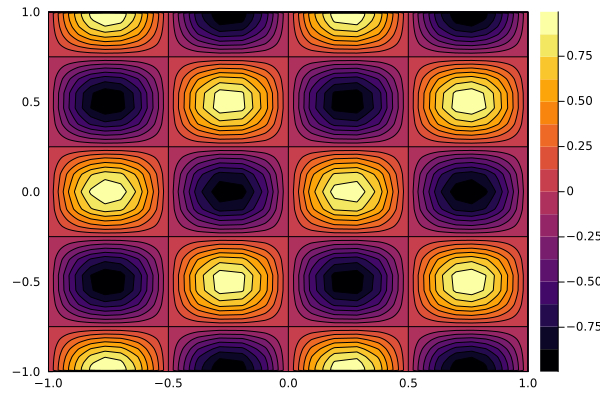

In [55]:
pcont = contour(xyleg, xyleg, sNoPreC, fill = true)
plot(pcont, format=:png)

Solution with preconditioner

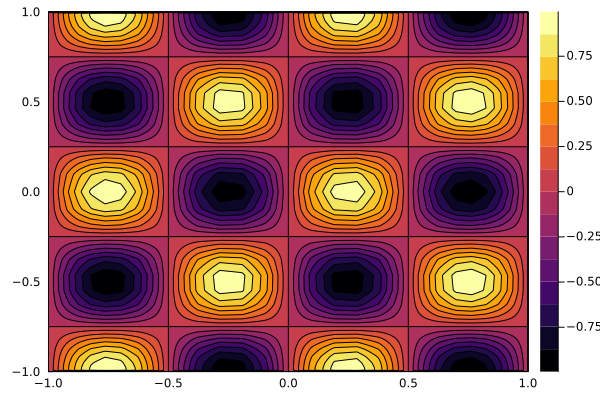

In [56]:
pcont = contour(xyleg, xyleg, sPreC, fill = true)
plot(pcont, format=:png)

Let's make a nice 3D visual

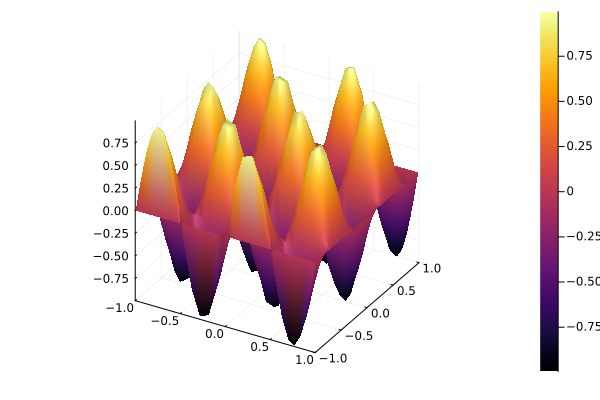

In [57]:

surf = surface(xyleg, xyleg,sPreC)
plot(surf, format=:png)


This is **Fig 5.1**

# 5.2.2 Nodal Galerkin Method

#### 5.2.2A Matrix-Free Calculations

We can then define the Continuous Nodal Galerkin Derivative Matrix:

\begin{align}
    G_{i,n}^{(x)} &= G_{n,i}^{(x)} = \sum_{k=0}^{N} D_{n,k}^{(x)} D_{i,k}^{(x)} w_k^{(x)} \\
    G_{j,m}^{(y)} &= G_{m,j}^{(y)} = \sum_{k=0}^{N} D_{m,k}^{(y)} D_{j,k}^{(y)} w_k^{(y)}
\tag{5.74}
\end{align}

For large problems this matrix could take up too much memory. So below we create a function for both the matrix and a function that outputs a single element depending on the indices

In [58]:
#eqn 5.74
#ch 5.2.2 pg 177
#This function produces one elment at the correct indices
function CNGLaplacianElement(x::Array{Float64},w::Array{Float64},wb::Array{Float64}, II::Int64,NN::Int64)

    N = length(x)-1

    G = 0.0

    for k in 0:N
        kk=k+1
        G = G + PolynomialDerivativeMatrixElement(x, wb,k,NN)*PolynomialDerivativeMatrixElement(x, wb,k,II)*w[kk]

    end

    return G   
        
end

#eqn 5.74
#ch 5.2.2 pg 177
#This function produces the entire matrix
function CNGDerivativeMatrix(N::Int64, x::Array{Float64}, w::Array{Float64})

    G = zeros(Float64, (N+1, N+1))
    D = PolynomialDerivativeMatrix(x)
    s = 0.0

    for j in 0:N
        jj = j+1
        for n in 0:N
            nn = n+1
            s = 0.0
            for k in 0:N
                kk = k+1
                s = s+ D[kk,nn]*D[kk,jj]*w[kk]
            end
            G[jj,nn] = s
        end

    end
    return G
end

CNGDerivativeMatrix (generic function with 1 method)

Let's make sure that our element function gives the correct element

In [59]:
nn =24
NN = nn
MM = nn
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
#barycentric weights
wb = BarycentricWeights(xyleg);

In [60]:
cg = CNGDerivativeMatrix(NN, xyleg, wleg);

In [61]:
cg[10,10]

27.690655554438322

In [62]:
CNGLaplacianElement(xyleg,wleg,wb,9,9)

27.690655554438322

Looks good!

Now we need to re-write the RHS algorithm

In [63]:
#alg 69a
function NodalGalerkinRHSComputation!(N::Int64, M::Int64, Phi::Array{Float64},x::Array{Float64}, y::Array{Float64},RHS::Array{Float64},S::Array{Float64}, wx::Array{Float64}, wy::Array{Float64},wbx::Array{Float64},wby::Array{Float64})


    #inputs
    #N,M - number of nodes minus one for each dimension (x,y)
    #Phi - current potential (2D)
    #RHS - Flattened vector of size L = (N-1)*(M-1)
    #S - 2D steady state source function
    #Dx,Dy - polynomial derivative matrix in x,y direction
    
    
    L = (N-1)*(M-1)
    #RHS = zeros(Float64, L+1)
    jj = zero(Int64)
    ii = zero(Int64)
    nn = zero(Int64)
    @. RHS = 0.0

    for j in 1:(M-1)
        jj=j+1
        for i in 1:(N-1)
            ii = i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            RHS[nn] = -wx[ii]*wy[jj]*S[ii,jj] - wy[jj]*CNGLaplacianElement(x,wx,wbx, i,0)*Phi[0+1,jj] - wy[jj]*CNGLaplacianElement(x,wx,wbx, i,N)*Phi[N+1,jj] - wx[ii]*CNGLaplacianElement(y,wy,wby, j,0)*Phi[ii,0+1] - wx[ii]*CNGLaplacianElement(y,wy,wby, j,M)*Phi[ii,M+1]
            #RHS[nn] = S[ii,jj] - Dx[ii, 0+1]*Phi[0+1,jj] - Dx[ii,N+1]*Phi[N+1,jj] - Dy[jj,0+1]*Phi[ii,0+1] - Dy[jj,M+1]*Phi[ii,M+1]

        end
    end
 
    return nothing

end

NodalGalerkinRHSComputation! (generic function with 1 method)

## `LinearMaps.jl` and `LinearOperators.jl`

Depending on which library we would like to use such as `IterativeSolvers.jl` or `Krylov.jl` we can use linear operators packages such as `LinearMaps.jl` and `LinearOperators.jl` for matrix-free operations

Because our operators vary with our inputs, we still need to use **Anonymous Functions**

Using `LinearMaps.jl` we can re-write our laplacian operator

In [67]:
#Alg 66
#eqn 5.77
#and eqn 5.79

CNGLapOperatorLinMaps = (x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64},wbx::Array{Float64}, wby::Array{Float64}) -> LinearMap((length(x))*(length(y)); ismutating=true) do dPhi,Phi

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. dPhi = 0.0
    #println(length(dPhi))

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            #dPhi[nn] = 0.0 #dPhi[ii,jj] = 0.0
            for k in 1:(N-1) #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1) #for Phi[k,j]
                dPhi[nn] = dPhi[nn] - wy[jj]*CNGLaplacianElement(x,wx,wbx, i,k)*Phi[nx]
            end
            for k in 1:(M-1) #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                dPhi[nn] = dPhi[nn] - wx[ii]*CNGLaplacianElement(y,wy,wby, j,k)*Phi[ny]
                #dPhi[nn] = dPhi[nn] + PolynomialDerivativeMatrixElement(y, j,k)*PolynomialDerivativeMatrixElement(y, j,k)*Phi[ny]
            end

        end
    end


    return dPhi


end

#43 (generic function with 1 method)

Using `LinearOperators.jl`

In [68]:
#Alg 66
#eqn 5.77
#and eqn 5.79

CNGLapOperatorLinOp = (x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64},wbx::Array{Float64}, wby::Array{Float64}) -> (dPhi,Phi,alpha,beta) -> begin

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. dPhi = 0.0
    #println(length(dPhi))

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            #dPhi[nn] = 0.0 #dPhi[ii,jj] = 0.0
            for k in 1:(N-1) #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1) #for Phi[k,j]
                dPhi[nn] = dPhi[nn] - wy[jj]*CNGLaplacianElement(x,wx,wbx, i,k)*Phi[nx]
            end
            for k in 1:(M-1) #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                dPhi[nn] = dPhi[nn] - wx[ii]*CNGLaplacianElement(y,wy,wby, j,k)*Phi[ny]
                #dPhi[nn] = dPhi[nn] + PolynomialDerivativeMatrixElement(y, j,k)*PolynomialDerivativeMatrixElement(y, j,k)*Phi[ny]
            end

        end
    end


end

#47 (generic function with 1 method)

### 5.2.2B Finite Element Preconditioner

In [69]:
#alg 78
#ch 5.2.2.4 pg 183
function Psi_Xi(k::Int64, l::Int64, eta::Int64)

    dPsi = zero(Float64)
    dPsi = -(-1.0)^k * (1.0-l-(-1.0)^l * eta)

    return dPsi

end

function Psi_Eta(k::Int64, l::Int64, xi::Int64)

    dPsi = zero(Float64)
    dPsi = -(-1.0)^l * (1.0-k-(-1.0)^k * xi)

    return dPsi

end

function gnmkl(dx::Float64, dy::Float64, n::Int64, m::Int64,k::Int64, l::Int64, r::Int64, s::Int64)

    g = Psi_Xi(k, l, s)*Psi_Xi(n, m, s)/dx^2 + Psi_Eta(k, l, r)*Psi_Eta(n, m, r)/dy^2
    return g

end

function LocalStiffnessMatrix(dx::Float64, dy::Float64)

    S = zeros(Float64, (4,4))
    t = 0.0

    for m in 0:1
        for n in 0:1
            p = n + 2*m + 1
            for l in 0:1
                for k in 0:1
                    q = k+2*l+1
                    # t = 0.0
                    # for s in 0:1
                    #     for r in 0:1

                    #         t = t + Psi_Xi(k, l, s)*Psi_Xi(n, m, s)/dx^2 + Psi_Eta(k, l, r)*Psi_Eta(n, m, r)/dy^2

                    #     end
                    # end
                    t = gnmkl(dx, dy,n,m, k, l, 0,0) + gnmkl(dx, dy,n,m, k, l, 1,0) + gnmkl(dx, dy, n,m,k, l, 0,1)+ gnmkl(dx, dy, n,m,k, l, 1,1)
                    S[p,q] = dx*dy*t/4.0
                end
            end
        end
    end

    return S

end

function StencilCoefficients(II::Int64, JJ::Int64, x::Array{Float64}, y::Array{Float64})


    Sp = Array{Any}(nothing, 4)
    C = zeros(Float64, (3,3))
    
    for m in 0:1
        for n in 0:1
            #p = n + 2*m + 1
            Sp[n+2*m+1] = LocalStiffnessMatrix(x[II-n+1+1] - x[II-n+1], y[JJ-m+1+1] - y[JJ-m+1])

        end
    end
    for m in 0:1
        for n in 0:1
            p = n + 2*m+1#p = n + 2*m+1
            # for l in -m:(-m+1)
            #     for k in -n:(-n+1)
            for k in -n:(-n+1)
                for l in -m:(-m+1)
                    q= (k+n) + 2*(l+m) + 1
                    #println(m,":::",n,"|||",k,":::",l,"|||",p,":::",q,"|||",k+2, ":::",l+2)
                    C[k+2,l+2] = C[k+2,l+2] + Sp[p][p,q]
                end
            end
        end
    end

    return C

end

StencilCoefficients (generic function with 1 method)

### Finite Element Preconditioner Matrix: Checking for Symmetry to use in Conjugate Gradient Method

In order to use the Conjugate Gradient Method, we need to have our preconditioner be symmetric operator. To do this, we need to actually get the matrix and view it to check for symmetry. Below, we do this

In [70]:
nn =8
NN = nn
MM = nn
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
#barycentric weights
wb = BarycentricWeights(xyleg)

A = zeros(Float64, ((NN+1)*(MM+1),(NN+1)*(MM+1)))
x = xyleg
y = xyleg
N = NN
M = MM
Cijkl = zeros(Float64,(3,3))

#@. B = 0.0
nmin = 1 
nmax = N
mmin = 1
mmax = M



for j in 1:M-1 #do not do y boundaries
    jj = j+1
    for i in 1:N-1#do not do x boundaries
        ii = i+1
        n = ii + (jj-1)*(N+1)
        Cijkl .= StencilCoefficients(i, j, x, y)
        for l in -1:1
            ll=l+2
            for k in -1:1
                kk = k+2
                nnn = ii+k + (jj+l-1)*(N+1)
                if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                    #println(ii,":::",jj,":::",kk,":::",ll,":::",nnn)
                    #B[n] = B[n] + Sten[kk,ll] * U[nnn]#Cijkl[k+2,l+2] * U[nn]
                    A[n,nnn] = A[n,nnn] +  Cijkl[kk,ll]
                end

            end
        end

    end
end



We plot our preconditioner matrix

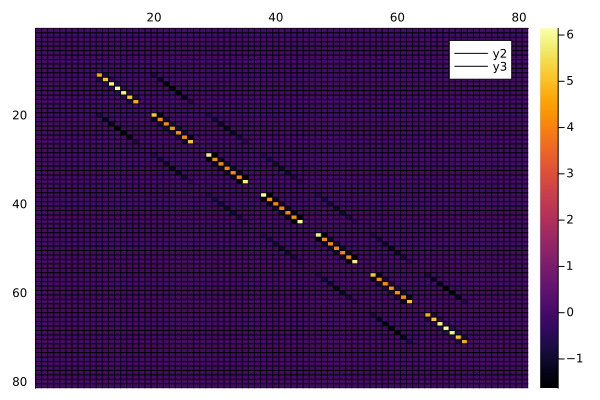

In [71]:
xs = [i for i = 1:size(A)[1]]
ys = [i for i = 1:size(A)[2]]
#z = float((1:4) * reshape(1:10, 1, :))
p = plot()
# hm = heatmap(xs, ys, A,xmirror = true,  yflip = true)#yflip = true)
heatmap!(xs, ys, A,xmirror = true,  yflip = true, fmt=:png)
#plot(hm,xguide = "x", yguide = "y", xmirror = true,  yflip = true)
mm, nn = size(A)
vline!(0.5:(nn+0.5), c=:black)
hline!(0.5:(mm+0.5), c=:black)
display(p)

Now use the `LinearAlgebra.issymetric()` function to check the matrix is symmetric

In [72]:
issymmetric(A)

true

Now we can see that the FE Preonditioner Matrix is symmetric

We will write the FE Preconditioner as a Linear Map in order to not save the entire matrix for large problems

In [73]:
#function FiniteElementPreconditioner!(X,B)
FEPreLinMaps = ( x::Array{Float64}, y::Array{Float64}) -> LinearMap((length(x))*(length(y)); issymmetric=true, ismutating=true) do U,B
    
    N = length(x) - 1
    M = length(y) - 1
    Cijkl = zeros(Float64,(3,3))

    @. B = 0.0
    
    for j in 1:M-1 #do not do y boundaries
        jj = j+1
        for i in 1:N-1 #do not do x boundaries
            ii = i+1
            n = ii + (jj-1)*(N+1)
            Cijkl .= StencilCoefficients(i, j, x, y)
            for l in -1:1
                ll=l+2
                for k in -1:1
                    #eqn 5.96
                    kk = k+2
                    nn = ii+k + (jj+l-1)*(N+1)
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        
                        #A[n,nnn] = A[n,nnn] +  Cijkl[kk,ll]
                        B[n] = B[n] + Cijkl[kk,ll] * U[nn]
                    # end

                end
            end
            # B[n] = B[n] + Cijkl[1,1] * U[ii-1 + (jj-1-1)*(N+1)] + Cijkl[2,1] + U[ii-0 + (jj-1-1)*(N+1)]+ Cijkl[3,1] * U[ii+1 + (jj-1-1) * (N+1)] + Cijkl[1,2] * U[ii-1 + (jj-0-1)*(N+1)] + Cijkl[2,2] * U[ii-0 + (jj-0-1)*(N+1)] + Cijkl[3,2] * U[ii+1 + (jj-0-1)*(N+1)] + Cijkl[1,3] * U[ii-1 + (jj+1-1)*(N+1)] + Cijkl[2,3] * U[ii-0 + (jj+1-1)*(N+1)] + Cijkl[3,3] * U[ii+1 + (jj+1-1)*(N+1)]

        end
    end
    return B

end

#51 (generic function with 1 method)

We can also use the  LinearOperators.jl package:

In [74]:
FEpreLinOp = (x::Array{Float64}, y::Array{Float64}) -> (U,B,alpha,beta) -> begin
    
    N = length(x) - 1
    M = length(y) - 1
    Cijkl = zeros(Float64,(3,3))

    @. B = 0.0

    for j in 1:M-1 #do not do y boundaries
        jj = j+1
        for i in 1:N-1 #do not do x boundaries
            ii = i+1
            n = ii + (jj-1)*(N+1)
            Cijkl .= StencilCoefficients(i, j, x, y)
            for l in -1:1
                for k in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        #eqn 5.96
                        nn = ii+k + (jj+l-1)*(N+1)
                        B[n] = B[n] + Cijkl[k+2,l+2] * U[nn]
                    # end

                end
            end

        end
    end
    #return B

end

#55 (generic function with 1 method)

To solve the preconditioner equation we use the single sweep SSOR. We can do it using LinearMaps.jl and LinearOperators.jl

In [76]:
#alg 79
#5.2.2.1 pg 186
#SSOR Sweep with Finite ELement Preconditioner using LinearMaps.jl
SSORSweepLinMaps = ( x::Array{Float64}, y::Array{Float64}, omega::Float64) -> LinearMap((length(x))*(length(y)); issymmetric=true,ismutating=true) do Z,R
    
    N = length(x)-1
    M = length(y)-1
    
    @. Z = 0.0
    s = 0.0
    Cijkl = zeros(Float64,(3,3))

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            #Z[n] = 0.0
            s = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1)#ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            Z[n] = Z[n] + omega * (R[n] - s)/Cijkl[0+2,0+2]
        end
    end

    for j in M-1:-1:1
        jj=j+1
        for i in N-1:-1:1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            s=0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1) #ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            Z[n] = Z[n] + omega * (R[n] - s)/Cijkl[0+2,0+2]
        end
    end

   
    return Z   


end

#63 (generic function with 1 method)

In [77]:
#alg 79
#5.2.2.1 pg 186
#SSOR Sweep with Finite ELement Preconditioner using LinearOperators.jl
SSORSweepLinOp = ( x::Array{Float64}, y::Array{Float64}, omega::Float64) ->(Z,R,alpha,beta) -> begin
    
    N = length(x)-1
    M = length(y)-1
    
    @. Z = 0.0
    s = 0.0
    Cijkl = zeros(Float64,(3,3))

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            #Z[n] = 0.0
            s = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1)#ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            Z[n] = Z[n] + omega * (R[n] - s)/Cijkl[0+2,0+2]
        end
    end

    for j in M-1:-1:1
        jj=j+1
        for i in N-1:-1:1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            s=0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1) #ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            Z[n] = Z[n] + omega * (R[n] - s)/Cijkl[0+2,0+2]
        end
    end


end

#67 (generic function with 1 method)

We re-write **Algorithm 35** to fit this problem

In [100]:
#Algorithm 35
function CoarseToFineInterpolation2Da(x::Array{Float64},  y::Array{Float64}, f::Matrix{Float64}, xx::Array{Float64},  yy::Array{Float64},xtol::Float64)

    wx = BarycentricWeights(x)
    wy = BarycentricWeights(y)
    #Tnewold = PolynomialInterpolationMatrix(x, xx, w,xtol)
    
    Nold = length(x)
    Mold = length(y)
    Nnew = length(xx)
    Mnew = length(yy)

    #for j in 1:Mold
    #end
    #just need matrix multiplication by vector
    #Fnewold = [Tnewold * f[:,j] for j in 1:Mold]
    # println("Phi : ",size(f))
    T = PolynomialInterpolationMatrix(x, xx, wx,xtol)
    # println("T : ",size(T))
    # println("phi[:,j] : ", size(f[:,1]))
    F1 = zeros(Float64, (Nnew,Mold))
    # println("F1 : ", size(F1))
    # println("F1[:,j] : ", size(F1[:,1]))
    for j in 1:Mold
        F1[:,j] .= T * f[:,j]
    end
    # println("F : ", size(F1))

    #w = BarycentricWeights(xx)
    T = PolynomialInterpolationMatrix(y, yy, wy,xtol)
    F2 = zeros(Float64, (Nnew,Mnew))
    for i in 1:Nnew
        F2[i,:] .= T * F1[i,:] 
    end

    return F2
    

end

CoarseToFineInterpolation2Da (generic function with 1 method)

In [284]:
#Hpresolve = (x,H,b) -> IterativeSolvers.ssor!(fill!(x, 0), H, b,w=1.3; maxiter=10)


### 5.2.2.6 Benchmark

Let's now benchmark our code with the initial boundary value problem of **Eqn 5.56**

In [79]:
## Create 2D nodes with N=M and Ntotal = 25
nn =24
NN = nn
MM = nn
#get Legendre Gauss Lobatto Nodes and Weights
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
#barycentric weights
wb = BarycentricWeights(xyleg)
#create source function
Fsource(x,y) = -8.0*pi^2*cos(2.0*pi*x)*sin(2.0*pi*y);


In [80]:
#create source matrix
Sij = [Fsource(i,j) for i in xyleg, j in xyleg];
#create Phi with dirichlet boundary conditions
p0 = zeros(Float64, (nn+1,nn+1))
@. p0[:,1] = 0.0 #Phi(x,-1) = 0.0
@. p0[end,:] = sin(2.0*pi*xyleg)
@. p0[:,end] = 0.0 #Phi(x,1) = 0.0
@. p0[1,:] = sin(2.0*pi*xyleg);
p1= deepcopy(p0);

In [81]:
#get RHS as a 1D vector from flattened 2D matrix
rhs = zeros(Float64, (NN+1)*(MM+1))
NodalGalerkinRHSComputation!(NN, MM, p1,xyleg, xyleg,rhs,Sij, wleg, wleg,wb,wb);

Check to see if the sizes of 2D correspond to flattened 1D

In [289]:
size(p1)

(25, 25)

In [290]:
size(p1)[1]*size(p1)[2]

625

In [291]:
size(rhs)

(625,)

Initialize LinearMaps and LinearOperators function

In [82]:

#LinearMaps
#laplacian operator matrix free
cnglapoplm = CNGLapOperatorLinMaps(xyleg, xyleg, wleg, wleg,wb, wb)

#preconditioner operator matrix free 
feprelm = FEPreLinMaps(xyleg,xyleg)
#Preconditioner solver
feprelmsolve = SSORSweepLinMaps(xyleg, xyleg, 1.4)

625×625 FunctionMap{Float64,true}(#64; issymmetric=true, ishermitian=true, isposdef=false)

Create operators from each library

In [83]:
#LinearOperators
#laplacian operator matrix free
cnglapoplo = CNGLapOperatorLinOp(xyleg, xyleg, wleg, wleg,wb, wb)
cnglapoplinop = LinearOperator(Float64, (NN+1)*(MM+1), (NN+1)*(MM+1), true, false,
                     (res, v) -> cnglapoplo(res, v, 1.0, 1.0),
                     nothing,
                     nothing)
#preconditioner operator matrix free 
feplo = FEpreLinOp(xyleg,xyleg) 
feplinop = LinearOperator(Float64, (NN+1)*(MM+1), (NN+1)*(MM+1), true, false,
                     (res, v) -> feplo(res, v, 1.0, 1.0),
                     nothing,
                     nothing)
#Preconditioner solver
feplosolve = SSORSweepLinOp(xyleg,xyleg,1.4) 
feplinopsolve = LinearOperator(Float64, (NN+1)*(MM+1), (NN+1)*(MM+1), true, false,
                     (res, v) -> feplosolve(res, v, 1.0, 1.0),
                     nothing,
                     nothing)

Linear operator
  nrow: 625
  ncol: 625
  eltype: Float64
  symmetric: true
  hermitian: false
  nprod:   0
  ntprod:  0
  nctprod: 0



Again, we need to use the Julia `struct` in order to use Multiple Dispatch and tell either `IterativeSolvers.jl` and `Krylov.jl` what the inverse of the operators are.

In [84]:
#struct for preconditioner
struct CNGPreCond{F,Finv, XX,YY}
	fun::F
    finv::Finv
    x::XX
    y::YY
end


In [85]:
#create preconditioner struct with linearmaps operators
PClinmap =CNGPreCond(feprelm,feprelmsolve,xyleg,xyleg);
#create preconditioner struct with linearoperators
PClinop =CNGPreCond(feplinop,feplinopsolve ,xyleg,xyleg);

In [86]:
# using LinearAlgebra
#need to define matrix inverse multiplication A^-1 * x for the preconditioner
#we will use the bicstabl method to solve the preconditioner inverse matrix problem
LinearAlgebra.ldiv!(Y, P::CNGPreCond , X) = Y.= P.finv * X#bicgstabl(P.fun, X, max_mv_products=400)
LinearAlgebra.ldiv!(P::CNGPreCond, X) = X.= P.finv * X


#### Using `IterativeSolvers.cg`

Now let's try using the conjugate gradient function of `IterativeSolvers.cg()`

In [87]:
ppp = IterativeSolvers.cg(cnglapoplm, rhs; log=true)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Converged after 70 iterations.)

Let's unflatten 1D to 2D

In [88]:
sol = zeros(Float64, (NN+1,MM+1))
for i in 1:NN+1
    for j in 1:MM+1
        nn = i + (j-1)*(NN+1)
        sol[i,j] = ppp[1][nn]
    end
end

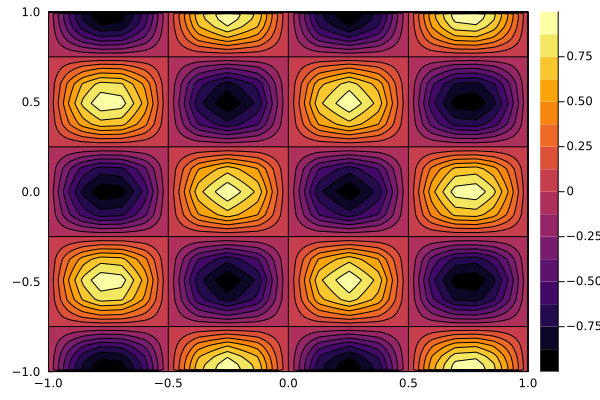

In [89]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

Now we can try with the preconditioner

In [90]:
ppp = IterativeSolvers.cg(cnglapoplm, rhs, Pl=PClinmap; log=true)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], Converged after 23 iterations.)

In [91]:
sol = zeros(Float64, (NN+1,MM+1))
for i in 1:NN+1
    for j in 1:MM+1
        nn = i + (j-1)*(NN+1)
        sol[i,j] = ppp[1][nn]
    end
end

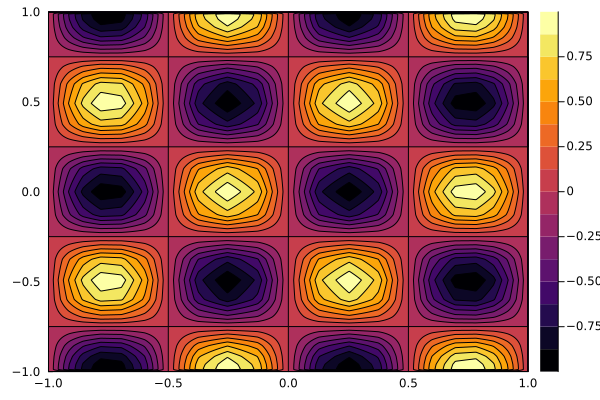

In [92]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

#### Using `Krylov.jl`

In [93]:
(x, stats) = Krylov.cg(cnglapoplinop, rhs)

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], SimpleStats
 niter: 70
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 715.80ms
 status: solution good enough given atol and rtol
)

In [94]:
sol = zeros(Float64, (NN+1,MM+1))
for i in 1:NN+1
    for j in 1:MM+1
        nn = i + (j-1)*(NN+1)
        sol[i,j] = x[nn]
    end
end

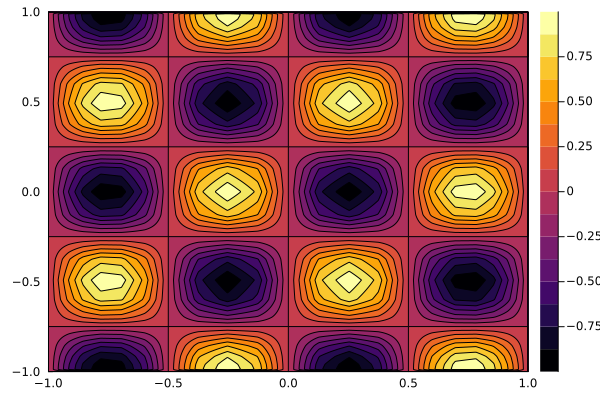

In [95]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

Now with preconditioner
Note: This is a LHS preconditioner

In [96]:
(x, stats) = Krylov.cg(cnglapoplinop, rhs, M=feplinopsolve, ldiv=false )

([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0], SimpleStats
 niter: 24
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 752.35ms
 status: solution good enough given atol and rtol
)

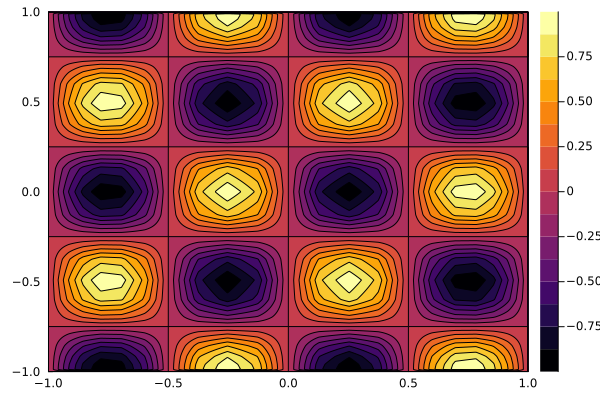

In [97]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

#### Now Interpolate to Square

In [101]:
Nout = 40
X = [-1+2*j/Nout for j in 0:Nout]
Y = [-1+2*j/Nout for j in 0:Nout]
# ww = BarycentricWeights(x)
# T = PolynomialInterpolationMatrix(x,X, ww,1.0e-9)
# Phiout = T*Phi

phiout = CoarseToFineInterpolation2Da(xyleg,  xyleg, sol,X,Y,1.0e-9);

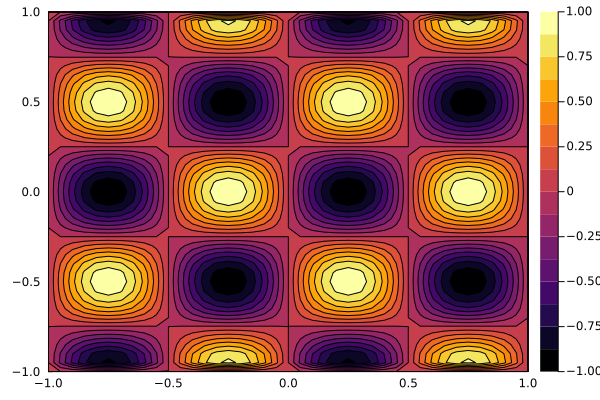

In [102]:
pcont = contour(X,Y, phiout, fill = true)
plot(pcont, format=:png)

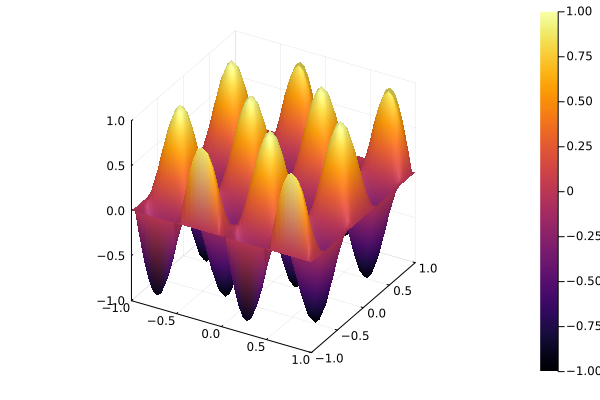

In [103]:
surf = surface(X,Y,phiout)
plot(surf, format=:png)

Great Job! only two more LONG sections to go!

# 5.3A Time Dependent Advection-Diffusion: Collocation

Advection-Diffusion Equation:

\begin{align}
    \frac{\partial}{\partial t}\varphi + \bar{q}\cdot \nabla\varphi &= \nu \nabla^2 \varphi, \:\:\:\:\:\:\: (x,y) \in (-1,1) \times (-1,1), \\
    \varphi(x,y,0) &= \varphi_0(x,y) , \:\:\:\:\:\:\: (x,y) \in [-1,1]\times [-1,1]
\tag{5.97}
\end{align}

Where the velocity field is described with:

\begin{align}
    \bar{q} = u \hat{x} + v \hat{y}
\end{align}

### 5.3.1 The Collocation Approximation

From the derivation all we need is Equations **5.100, 5.101, 5.102**

### How to Implement

Again we'll create matrix-free operators using `LinearMaps.jl` and `LinearOperators.jl`

In [104]:
#collocation Transport Operator
ColTranOp = (x::Array{Float64}, y::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64}, u::Function, v::Function) -> LinearMap((length(x))*(length(y)); ismutating=true) do qdPhi,Phi
# function LaplaceOperator!(Phi::Array{Float64}, dPhi::Array{Float64}, x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64},  wbx::Array{Float64}, wby::Array{Float64}, DirBound1::Function, DirBound2::Function, DirBound3::Function,  DirBound4::Function)
    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. qdPhi = 0.0
    qdphi = 0.0 #dummy variable to store summation

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            qdphi = 0.0
            for k in 0:N #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(x, wbx,i,k)*Phi[nx]
            end
            #add x summation to qdPhi and multiply by u velocity field
            qdPhi[nn] = qdPhi[nn] + u(x[ii])*qdphi
            #reset dummy variable
            qdphi = 0.0 
            for k in 0:M #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(y, wby,j,k)*Phi[ny]
            end
            #add v velocity field times y summation to qdPhi
            qdPhi[nn]= qdPhi[nn] + v(y[jj])*qdphi
            #finally multiply by weights for galerkin only
            #qdPhi[nn] = qdPhi[nn]*wx[ii]*wy[jj]

        end
    end


    return qdPhi


end

#87 (generic function with 1 method)

In [105]:
GalTranOp = (x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64}, u::Function, v::Function) -> LinearMap((length(x))*(length(y)); ismutating=true) do qdPhi,Phi

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. qdPhi = 0.0
    #println(length(dPhi))
    qdphi = 0.0 #dummy variable to store summation

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            qdphi = 0.0
            for k in 0:N #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(x, wbx,i,k)*Phi[nx]
            end
            #add x summation to qdPhi and multiply by u velocity field
            qdPhi[nn] = qdPhi[nn] + u(x[ii])*qdphi
            #reset dummy variable
            qdphi = 0.0 
            for k in 0:M #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(y, wby,j,k)*Phi[ny]
            end
            #add v velocity field times y summation to qdPhi
            qdPhi[nn]= qdPhi[nn] + v(y[jj])*qdphi
            #finally multiply by weights
            qdPhi[nn] = qdPhi[nn]*wx[ii]*wy[jj]

        end
    end


    return qdPhi


end

#91 (generic function with 1 method)

### 5.3.3A Time Integration: Collocation

We have the LHS and RHS for both the collocation and galerkin methods. 

For the time integration we will use the Implicit Third Order Backwards Differentiation method (**BDF**). To solve this equation (**5.112** & **5.113**) we will use iterative methods we used in previous chapters. 

We will create a mutable struct in order to hold the four time steps of $\Phi$

\begin{align}
    \left[ \begin{array}{ccc}
            \Phi^{n+1}\\
            \Phi^{n} \\
            \Phi^{n-1}\\
            \Phi^{n-2} 
            \end{array}\right]
\end{align}

In [106]:
#mutablestruct in order to hold the Phi from two previous time steps
mutable struct Phin{P1,P2,P3,P4}
    p1::P1
    p2::P2
    p3::P3
    p4::P4
end

Next we create a function to calculate the RHS for each step using **Eqn 5.115**

In [107]:
#third order semi implicit time integration for collocation
#RHS
function RHSIMEX3Collocation!(rhs::Array{Float64},phi::Phin, dt::Float64, qD::FunctionMap{Float64})

    #phi is a struct with 
    #phi.p1-> Phi^{n+1}
    #phi.p2 -> Phi^{n}
    #phi.p3 -> Phi^{n-1}
    #phi.p4 -> Phi^{n-2}
    @. rhs = 0.0
    one11 = 1.0/11.0
    dt611 = -6.0*dt/11.0

    qdphi2 = qD*phi.p2
    qdphi3 = qD*phi.p3
    qdphi4 = qD*phi.p4
    

     for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1)

            rhs[nn] = one11*(18.0*phi.p2[nn] -9*phi.p3[nn] +2.0*phi.p4[nn]) + dt611*(3.0*qdphi2[nn] - 3.0*qdphi3[nn] + qdphi4[nn])


        end
    end

    return nothing
    

end


RHSIMEX3Collocation! (generic function with 1 method)

And for the Galerkin method **Eqn 5.118**

In [108]:
#third order semi implicit time integration for Gallerkin
#RHS
function RHSIMEX3Galerkin!(rhs::Array{Float64},phi::Phin, wx::Array{Float64}, wy::Array{Float64}, dt::Float64,  qD::FunctionMap{Float64})

    #phi is a struct with 
    #phi.p1-> Phi^{n+1}
    #phi.p2 -> Phi^{n}
    #phi.p3 -> Phi^{n-1}
    #phi.p4 -> Phi^{n-2}
    @. rhs = 0.0
    one11 = 1.0/11.0
    dt611 = -6.0*dt/11.0

    qdphi2 = qD*phi.p2
    qdphi3 = qD*phi.p3
    qdphi4 = qD*phi.p4
    

     for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1)

            rhs[nn] = wx[ii]*wy[jj]*one11*(18.0*phi.p2[nn] -9*phi.p3[nn] +2.0*phi.p4[nn]) + dt611*(3.0*qdphi2[nn] - 3.0*qdphi3[nn] + qdphi4[nn])


        end
    end

    return nothing
    

end

RHSIMEX3Galerkin! (generic function with 1 method)

Next we do the LHS. 

FOr the coolocation method it's **Eqn 5.102** and **Eqn 5.112**

In [109]:
#LHS operator for Collocation Method with LinearMaps
LHSCollocationLinMaps = (N::Int64, M::Int64, nu::Float64, dt::Float64, LapD::FunctionMap{Float64}) -> LinearMap((N+1)*(M+1); ismutating=true) do dPhi,Phi

    dtnu611 = -6.0*dt * nu/11.0
    
    LPhi = LapD*Phi 
    
    @. dPhi = 0.0
    @. dPhi = Phi + dtnu611*LPhi
    # for j in 0:M
    #     jj=j+1
    #     for i in 0:N
    #         ii=i+1
    #         nn = ii + (jj-1)*(N+1)
    #         dPhi[nn] = Phi[nn] - dtnu611 * LPhi[nn]
    #     end
    # end


    return dPhi


end

#95 (generic function with 1 method)

In [110]:
#with LinearOperators
LHSCollocationLinOp = (N::Int64, M::Int64, nu::Float64, dt::Float64, LapD::FunctionMap{Float64}) -> (dPhi,Phi,alpha,beta) -> begin

    dtnu611 = -6.0*dt * nu/11.0
    
    LPhi = LapD*Phi 
    
    @. dPhi = 0.0
    @. dPhi = Phi + dtnu611*LPhi
    # for j in 0:M
    #     jj=j+1
    #     for i in 0:N
    #         ii=i+1
    #         nn = ii + (jj-1)*(N+1)
    #         dPhi[nn] = Phi[nn] - dtnu611 * LPhi[nn]
    #     end
    # end


end

#99 (generic function with 1 method)

FOr the Galerkin method it's **Eqn 5.111** and **Eqn 5.113**

For now we leave these commented out since we will use them in the next section

In [1]:
# #LHS operator Galerkin Method with LinearMaps
# LHSGalerkinMaps = (N::Float64, M::Float64, wx::Array{Float64}, wy::Array{Float64}, nu::Float64, dt::Float64, LapD::FunctionMap{Float64}) -> LinearMap((length(x))*(length(y)); ismutating=true) do dPhi,Phi

#     dtnu611 = -6.0*dt * nu/11.0
#     @. dPhi = 0.0
#     dPhi .= dtnu611 .* LapD*Phi 
    
#     for j in 0:M
#         jj=j+1
#         for i in 0:N
#             ii=i+1
#             nn = ii + (jj-1)*(N+1)
#             dPhi[nn] = x[ii]*wy[jj]*Phi[nn] + dPhi[nn] 
#         end
#     end


#     return dPhi


# end

In [2]:
# #LHS operator Galerkin Method with LinearOperators
# LHSGalerkinLinOp = (N::Float64, M::Float64, wx::Array{Float64}, wy::Array{Float64}, nu::Float64, dt::Float64, LapD::FunctionMap{Float64}) -> (dPhi,Phi,alpha,beta) -> begin

#     dtnu611 = -6.0*dt * nu/11.0
#     @. dPhi = 0.0
#     dPhi .= dtnu611 .* LapD*Phi 
    
#     for j in 0:M
#         jj=j+1
#         for i in 0:N
#             ii=i+1
#             nn = ii + (jj-1)*(N+1)
#             dPhi[nn] = x[ii]*wy[jj]*Phi[nn] + dPhi[nn] 
#         end
#     end


#     #return dPhi


# end

#### Reusing RK3

We will need to reuse RK3 for the first 2 steps to obtain $\Phi^{n-1}$ and $\Phi^{n}$ given the initial value of $\Phi^{n-2}$

For the collocation method we need to use the RK3 meethod to solve:

\begin{align}
    \frac{d}{dt}  \Phi_{i,j} &= \nu \nabla^2_{N,M} \Phi_{i,j} - \bar{q}\cdot \nabla_{N,M} \Phi_{i,j} \\
    i,j &= 1,2,3 .... N-1,M-1 \;\;\;\:\: \:\:\: For \: Dirichlet \: BC \\
    i,j &= 0,1,2,3 .... N,M \;\;\;\:\: \:\:\: For \: Neumann \: BC
\tag{5.100}
\end{align}

And for the Galerkin:

\begin{align}
    w_i^x w_j^y \frac{d}{dt}  \Phi_{i,j} &= \nu \left( \nabla^2_{N,M} \:\Phi_{i,j}\:, \:l_i l_j \right)_{N,M} - \left(\bar{q}\cdot \nabla_{N,M} \:\Phi_{i,j} \:, \: l_i l_j \right)\\
    \frac{d}{dt}  \Phi_{i,j} &\Rightarrow\frac{1}{w_i^x w_j^y} \left[ \nu \left( \nabla^2_{N,M} \:\Phi_{i,j}\:, \:l_i l_j \right)_{N,M} - \left(\bar{q}\cdot \nabla_{N,M} \:\Phi_{i,j} \:, \: l_i l_j \right) \right]\\
    i,j &= 1,2,3 .... N-1,M-1 \;\;\;\:\: \:\:\: For \: Dirichlet \: BC \\
    i,j &= 0,1,2,3 .... N,M \;\;\;\:\: \:\:\: For \: Neumann \: BC
\tag{5.109}
\end{align}

First we need to figure out the inputs. 

We need all the regular ones plus we need the Laplace Operator and Transport (Advection) Operator

In [113]:
#Alg 50D
#
function InitCollocationStepRK3!(tn::Float64, dt::Float64, nu::Float64, Phiold::Array{Float64}, Phinew::Array{Float64}, LAP::FunctionMap{Float64}, TRAN::FunctionMap{Float64})

    am = [0.0; -5.0/9.0; -153.0/128.0]
    bm = [0.0; 1.0/3.0; 0.75]
    gm = [1.0/3.0; 15.0/16.0; 8.0/15.0]
    t = 0.0
    N = length(Phiold)
    @. Phinew = Phiold
    DPhi = zeros(Float64, N)
    G = zeros(Float64, N)

    for m in 1:3
        t = tn +bm[m]*dt
        #time derivative
        DPhi .= nu * LAP*Phinew .- TRAN*Phinew
        @. G = am[m]*G + DPhi
        @. Phinew = Phinew + gm[m] *dt *G
        

    end
    #dirichlet boundary conditions
    #Phi[1] = 0.0
    #Phi[end] = 0.0

    return nothing

end

InitCollocationStepRK3! (generic function with 1 method)

In [114]:
#Alg 50D
function InitGallerkinStepRK3!(tn::Float64, dt::Float64, nu::Float64,  Phiold::Array{Float64}, Phinew::Array{Float64},  wx::Array{Float64}, wy::Array{Float64}, LAP::FunctionMap{Float64}, TRAN::FunctionMap{Float64})

    am = [0.0; -5.0/9.0; -153.0/128.0]
    bm = [0.0; 1.0/3.0; 0.75]
    gm = [1.0/3.0; 15.0/16.0; 8.0/15.0]
    t = 0.0
    N = length(wx)-1
    M = length(wy)-1
    #Phij = copy(Phi)
    DPhi = zeros(Float64, size(Phi))
    G = zeros(Float64, size(Phi))

    for m in 1:3
        t = tn +bm[m]*dt
        #time derivative
        DPhi .= nu * LAP*Phi .- TRAN*Phi
        #need to divide by weights
        for j in 1:M
            jj=j+1
            for i in 1:N
                ii=i+1
                nn = ii + (jj-1)*(N+1)
                DPhi[nn] = 1.0/(wx[ii]*wy[jj])*DPhi[nn]
                
            end
        end
        @. G = am[m]*G + DPhi
        @. Phi = Phi + gm[m] *dt *G
        

    end
    #dirichlet boundary conditions
    #Phi[1] = 0.0
    #Phi[end] = 0.0

    return nothing

end

InitGallerkinStepRK3! (generic function with 1 method)

#### Preconditioner

Next we need to make a preconditioner to solve the IMEX3 method. We will modify the Finite Difference Preconditioner using **Eqn 5.120-1.22**:

\begin{align}
    \left( H_{FD} \: u \right)_{ij} = \hat{A}_{ij} u_{ij} + \hat{B}_{ij} u_{i-1,j} +\hat{C}_{i,j} u_{i,j-1}+ \hat{E}_{ij} u_{i+1,j} + \hat{F}_{ij} u_{i,j+1}
\tag{5.120}
\end{align}

\begin{align}
    \hat{A}_{ij} = 1 - \frac{6\nu \: \Delta t}{11} A_{ij}
\tag{5.121}
\end{align}

\begin{align}
    \hat{B}_{ij} = - \frac{6\nu \: \Delta t}{11} B_{ij}
\tag{5.121}
\end{align}

\begin{align}
    \hat{C}_{ij} = - \frac{6\nu \: \Delta t}{11} C_{ij}
\tag{5.121}
\end{align}

\begin{align}
    \hat{F}_{ij} = - \frac{6\nu \: \Delta t}{11} F_{ij}
\tag{5.121}
\end{align}

\begin{align}
    \hat{F}_{ij} = - \frac{6\nu \: \Delta t}{11} F_{ij}
\tag{5.121}
\end{align}

Because According to the LHS of **Eqn 5.114**:

\begin{align}
    \left( \underline{I} - \frac{6\: \nu \Delta t}{11} \bar{\nabla}^2 \right) \Phi_{ij}
\end{align}

In [115]:
#eqn 5.37 & 5.38
#Eqns 5.12-5.122

# hatAij(dt::Float64, nu::Float64, dxi::Float64, dxip1::Float64,dyj::Float64, dyjp1::Float64) = 1.0 - 6.0*nu*dt/11.0 * Aij(dxi, dxip1,dyj, dyjp1)#-2*(1/(dxi*dxip1) + 1/(dyj*dyjp1))
# hatBij(dt::Float64, nu::Float64,dxi::Float64, dxip1::Float64) = - 6.0*nu*dt/11.0 *Bij(dxi, dxip1)#2*1/(dxi*(dxi+dxip1))
# hatCij(dt::Float64, nu::Float64,dyj::Float64, dyjp1::Float64) = - 6.0*nu*dt/11.0 *Cij(dyj, dyjp1)#2*1/(dyj*(dyj+dyjp1))
# hatEij(dt::Float64, nu::Float64,dxi::Float64, dxip1::Float64) = - 6.0*nu*dt/11.0 *Eij(dxi, dxip1)#2*1/(dxip1*(dxi+dxip1))
# hatFij(dt::Float64, nu::Float64,dyj::Float64, dyjp1::Float64) = - 6.0*nu*dt/11.0 *Fij(dyj, dyjp1)#2*1/(dyjp1*(dyj+dyjp1))


IMEX3FDPreCon = (x::Array{Float64}, y::Array{Float64}, dt::Float64, nu::Float64) -> LinearMap((length(x))*(length(y)); ismutating=true) do Z,U

    N = length(x) - 1
    M = length(y) - 1
    @. Z = 0.0
    dtnu611 = -6.0*dt*nu/11.0

    for j in 1:M-1
        jj = j+1
        for i in 1:N-1
            ii = i+1
            nn = ii + (jj-1)*(N+1)
            nnim1 = ii-1 + (jj-1)*(N+1)
            nnjm1 = ii + (jj-1-1)*(N+1)
            nnip1 = ii+1 + (jj-1)*(N+1)
            nnjp1 = ii + (jj-1+1)*(N+1)
            
            Z[nn] = (1.0 + dtnu611*Aij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii]), (y[jj]-y[jj-1]), (y[jj+1]-y[jj]) ) )* U[nn] + dtnu611*Bij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii]) ) * U[nnim1] +  dtnu611*Cij( (y[jj]-y[jj-1]), (y[jj+1]-y[jj]) ) * U[nnjm1] + dtnu611*Eij( (x[ii]-x[ii-1]) , (x[ii+1]-x[ii])  ) * U[nnip1] + dtnu611*Fij( (y[jj]-y[jj-1]), (y[jj+1]-y[jj])  ) * U[nnjp1]

        end
    end

    return Z
    

end

#111 (generic function with 1 method)

### 5.3.5 Benchmark Solution: Advection and Diffusion of a Spot in a Uniform Flow

#### Collocation

Now we have everything we need. We will benchmark with:

In [116]:
u(x) = 0.8
v(y) = 0.8

phian(x,y,t, u,v, nu, x0, y0) = 1.0/(4.0*t +1.0 ) * exp(-( (x -u(x) *t -x0)^2 + (y -v(y) *t -y0)^2) / ( nu*(4.0*t + 1) ))

phian (generic function with 1 method)

In [117]:
#initial conditions
x0 = -0.5
y0 = -0.5
nu = 0.01
dt = 3.0e-4

nn = 28
N = nn
M = nn


xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
wb = BarycentricWeights(xyleg)

tstart = 0.0

p0 = [phian(xyleg[i],xyleg[j],tstart, u,v, nu, x0, y0) for i in 1:N+1, j in 1:M+1]
p1= deepcopy(p0);
P = Phin(zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)),  vec(p1));

In [118]:
#dt = 3.0e-4
#Set up Laplace Operator
ColLOp = CollocationLapOp(xyleg, xyleg, wb,wb)
#set up Transport operator
ColTOp = ColTranOp(xyleg, xyleg, wb,wb, u, v) #CollocationTranOp(xyleg, xyleg, wb,wb, u, v) 
#construct our mutable struct
P = Phin(zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)),  vec(p1));
#calculate first 2 steps withe xplicit RK3
InitCollocationStepRK3!(0.0, dt, nu,P.p4,P.p3, ColLOp, ColTOp)
InitCollocationStepRK3!(dt, dt, nu,P.p3,P.p2, ColLOp, ColTOp)

Let's take a look at our results from the RK3:

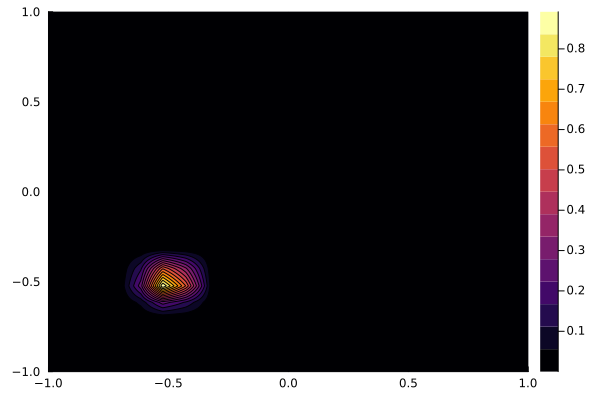

In [119]:
pcont = contour(xyleg,xyleg, P.p4, fill = true)
plot(pcont, format=:png)#, size=(400,300))

Now we set up for the IMEX3 calculation. We need the LHS Matrix-Free Operator

**Note:** because the IMEX3 is unconditionably stable we can increase the time step to make it faster

In [120]:
#let's increase dt
#dt = 3.0e-4
dt = 10.0*dt
t_total = 0.5
nt = ceil(Int64, t_total/dt)

167

In [121]:
nt*0.1465 #total seconds minimum simulation should take

24.4655

With new $\Delta t$ we need to initialize our Preconditioner and LHS Collocation operator

In [122]:
#Need to define a preconditioner struc
# struct PreCond{A}
# 	fun::A
# end
#set up Finite Difference Preconditioner
FDpre = IMEX3FDPreCon(xyleg,xyleg, dt, nu) 
PC = PreCond(FDpre);

In [123]:
# using LinearAlgebra
#need to define matrix inverse multiplication A^-1 * x for the preconditioner
#we will use the bicstabl method to solve the preconditioner inverse matrix problem
LinearAlgebra.ldiv!(Y, Pc::PreCond, X) = Y.= IterativeSolvers.bicgstabl(Pc.fun, X, max_mv_products=400)
LinearAlgebra.ldiv!(Pc::PreCond, X) = X.= IterativeSolvers.bicgstabl(Pc.fun, X, max_mv_products=400)


Now we set up for the IMEX3 calculation. We need the LHS Matrix-Free Operator

In [124]:
#LHS operator for Collocation Method
ColLHSOp = LHSCollocationLinMaps(N, M, nu, dt, ColLOp)
#test
#maximum(ColLHSOp*P.p2)

841×841 FunctionMap{Float64,true}(#96; issymmetric=false, ishermitian=false, isposdef=false)

Next we will implement the time stepping function which calculates the RHS of **Eqn 5.112**

In [125]:
function ColSolveDiffAdv!(Nt::Int64, dt::Float64, phi::Phin, LHSLAP::FunctionMap{Float64}, RHSTRAN::FunctionMap{Float64}, pc::PreCond) #, x::Array{Float64}, y::Array{Float64},  wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64})

    RHS = zeros(Float64, length(phi.p1))
    

    for n in 1:Nt
        #make RHS vector
        RHSIMEX3Collocation!(RHS,phi, dt,  RHSTRAN)
        #solve Ax =b
        phi.p1 = bicgstabl(LHSLAP, RHS,Pl=pc, max_mv_products=400)
        #push phi^n
        phi.p4 .= phi.p3
        phi.p3 .= phi.p2
        phi.p2 .= phi.p1


    end
    

    return nothing
    
end

ColSolveDiffAdv! (generic function with 1 method)

In [126]:
ColSolveDiffAdv!(nt, dt, P, ColLHSOp, ColTOp, PC)

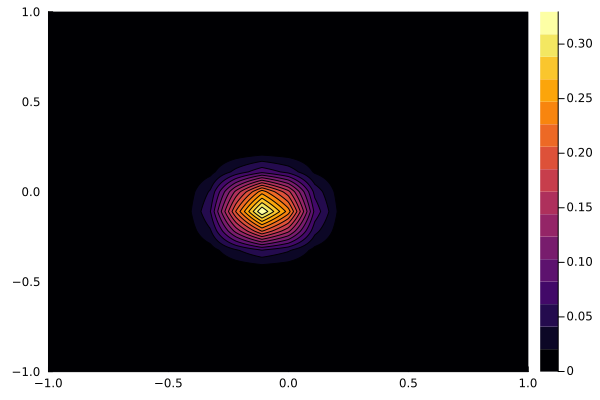

In [127]:
pcont = contour(xyleg,xyleg, P.p1, fill = true)
plot(pcont, format=:png)#, size=(400,300))


Which is close to **Fig. 5.4**

## 5.3B Time Dependent Advection-Diffusion: Galerkin

### 5.3.2 The Nodal Galerkin Approximation

To solve the preconditioner equation we use the single sweep SSOR. We can do it using LinearMaps.jl and LinearOperators.jl

For the Galerkin Method, we'll try something different. We'll use LinearMaps.jl with IteraveSolvers.jl and LinearOperators.jl and Krylov.jl

We can find the tutorial for linearoperators here: https://jso.dev/tutorials/introduction-to-linear-operators/

In [128]:
#Transport Operator with Linear Maps
GalTranOpLinMaps = (x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64}, u::Function, v::Function) -> LinearMap((length(x))*(length(y)); ismutating=true) do qdPhi,Phi

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. qdPhi = 0.0
    #println(length(dPhi))
    qdphi = 0.0 #dummy variable to store summation

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            qdphi = 0.0
            for k in 0:N #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(x, wbx,i,k)*Phi[nx]
            end
            #add x summation to qdPhi and multiply by u velocity field
            qdPhi[nn] = qdPhi[nn] + u(x[ii])*qdphi
            #reset dummy variable
            qdphi = 0.0 
            for k in 0:M #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(y, wby,j,k)*Phi[ny]
            end
            #add v velocity field times y summation to qdPhi
            qdPhi[nn]= qdPhi[nn] + v(y[jj])*qdphi
            #finally multiply by weights
            qdPhi[nn] = qdPhi[nn]*wx[ii]*wy[jj]

        end
    end


    return qdPhi


end

#117 (generic function with 1 method)

In [129]:
#Transport Operator with Linear Maps
GalTranOpLinOp = (x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64}, u::Function, v::Function) -> (qdPhi,Phi, alpha, beta) -> begin

    #uses barycentric weights
    N = length(x)-1
    M = length(y)-1

    #set all to zeros
    @. qdPhi = 0.0
    #println(length(dPhi))
    qdphi = 0.0 #dummy variable to store summation

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1) #columnwise/fortran
            # nn = j + (i-1)*(M-1) #rowwise/c
            qdphi = 0.0
            for k in 0:N #sum over x
                kk = k+1
                nx = kk + (jj-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(x, wbx,i,k)*Phi[nx]
            end
            #add x summation to qdPhi and multiply by u velocity field
            qdPhi[nn] = qdPhi[nn] + u(x[ii])*qdphi
            #reset dummy variable
            qdphi = 0.0 
            for k in 0:M #sum over y
                kk = k+1
                ny = ii + (kk-1)*(N+1)
                qdphi = qdphi + PolynomialDerivativeMatrixElement(y, wby,j,k)*Phi[ny]
            end
            #add v velocity field times y summation to qdPhi
            qdPhi[nn]= qdPhi[nn] + v(y[jj])*qdphi
            #finally multiply by weights
            qdPhi[nn] = qdPhi[nn]*wx[ii]*wy[jj]

        end
    end


    #return qdPhi


end

#121 (generic function with 1 method)

FOr the Galerkin method it's **Eqn 5.111** and **Eqn 5.113**

In [130]:
#third order semi implicit time integration for Gallerkin
#RHS
function RHSIMEX3Galerkin!(rhs::Array{Float64},phi::Phin, wx::Array{Float64}, wy::Array{Float64}, dt::Float64,  qD::FunctionMap{Float64})

    #phi is a struct with 
    #phi.p1-> Phi^{n+1}
    #phi.p2 -> Phi^{n}
    #phi.p3 -> Phi^{n-1}
    #phi.p4 -> Phi^{n-2}
    N = length(wx)-1
    M = length(wy) - 1
    @. rhs = 0.0
    one11 = 1.0/11.0
    dt611 = -6.0*dt/11.0

    qdphi2 = qD*phi.p2
    qdphi3 = qD*phi.p3
    qdphi4 = qD*phi.p4
    

     for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii=i+1
            nn = ii + (jj-1)*(N+1)

            rhs[nn] = wx[ii]*wy[jj]*one11*(18.0*phi.p2[nn] -9*phi.p3[nn] +2.0*phi.p4[nn]) + dt611*(3.0*qdphi2[nn] - 3.0*qdphi3[nn] + qdphi4[nn])


        end
    end

    return nothing
    

end

RHSIMEX3Galerkin! (generic function with 1 method)

In [131]:
#LHS operator Galerkin Method with LinearMaps
LHSGalerkinMaps = (N::Int64, M::Int64, wx::Array{Float64}, wy::Array{Float64}, nu::Float64, dt::Float64, LapD::FunctionMap{Float64}) -> LinearMap((length(x))*(length(y)); ismutating=true) do dPhi,Phi

    dtnu611 = -6.0*dt * nu/11.0
    @. dPhi = 0.0
    dPhi .= LapD*Phi 
    
    for j in 0:M
        jj=j+1
        for i in 0:N
            ii=i+1
            nn = ii + (jj-1)*(N+1)
            dPhi[nn] = wx[ii]*wy[jj]*Phi[nn] + dtnu611*dPhi[nn] 
        end
    end


    return dPhi


end

#125 (generic function with 1 method)

In [132]:
#LHS operator Galerkin Method with LinearOperators
#LHSGalerkinLinOp
LHSGalerkinLinOp = (N::Int64, M::Int64, wx::Array{Float64}, wy::Array{Float64}, nu::Float64, dt::Float64, LapD::LinearOperator{Float64}) -> (dPhi,Phi,alpha,beta) -> begin

    dtnu611 = -6.0*dt * nu/11.0
    @. dPhi = 0.0
    dPhi .=  LapD*Phi 
    
    for j in 0:M
        jj=j+1
        for i in 0:N
            ii=i+1
            nn = ii + (jj-1)*(N+1)
            dPhi[nn] = wx[ii]*wy[jj]*Phi[nn] + dtnu611*dPhi[nn] 
        end
    end


    #return dPhi


end

#129 (generic function with 1 method)

#### Reusing RK3

In [133]:
#Alg 50D
function InitGallerkinStepRK3!(tn::Float64, dt::Float64, nu::Float64,  Phiold::Array{Float64}, Phinew::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, LAP::FunctionMap{Float64}, TRAN::FunctionMap{Float64})

    am = [0.0; -5.0/9.0; -153.0/128.0]
    bm = [0.0; 1.0/3.0; 0.75]
    gm = [1.0/3.0; 15.0/16.0; 8.0/15.0]
    t = 0.0
    N = length(wx)-1
    M = length(wy)-1
    Phinew .= Phiold
    DPhi = zeros(Float64, size(Phinew))
    G = zeros(Float64, size(Phinew))

    for m in 1:3
        t = tn +bm[m]*dt
        #time derivative
        DPhi .= nu * LAP*Phinew .- TRAN*Phinew
        #need to divide by weights
        for j in 1:M
            jj=j+1
            for i in 1:N
                ii=i+1
                nn = ii + (jj-1)*(N+1)
                DPhi[nn] = 1.0/(wx[ii]*wy[jj])*DPhi[nn]
                
            end
        end
        @. G = am[m]*G + DPhi
        @. Phinew = Phinew + gm[m] *dt *G
        

    end
    #dirichlet boundary conditions
    #Phi[1] = 0.0
    #Phi[end] = 0.0

    return nothing

end

InitGallerkinStepRK3! (generic function with 1 method)

In [134]:
#mutablestruct in order to hold the Phi from two previous time steps
# mutable struct Phin{P1,P2,P3,P4}
#     p1::P1
#     p2::P2
#     p3::P3
#     p4::P4
# end

#### Finite Element Preconditioner for Time Dependent Adv-Diff

Let's check to see the symmetry on the FE Preconditioner for the Time Dependent Advection-Diffusion using **Eqn 5.113**

In [135]:
nn =8
NN = nn
MM = nn
xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
#barycentric weights
wb = BarycentricWeights(xyleg)

A = zeros(Float64, ((NN+1)*(MM+1),(NN+1)*(MM+1)))
x = xyleg
y = xyleg
N = NN
M = MM
Cijkl = zeros(Float64,(3,3))

#@. B = 0.0
nmin = 1 
nmax = N
mmin = 1
mmax = M



for j in 1:M-1 #do not do y boundaries
    jj = j+1
    for i in 1:N-1#do not do x boundaries
        ii = i+1
        n = ii + (jj-1)*(N+1)
        #set the first part of LHS
        A[n,n] = wleg[ii]*wleg[jj]
        Cijkl .= StencilCoefficients(i, j, x, y)
        for l in -1:1
            ll=l+2
            for k in -1:1
                kk = k+2
                nnn = ii+k + (jj+l-1)*(N+1)
                if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                    #println(ii,":::",jj,":::",kk,":::",ll,":::",nnn)
                    #B[n] = B[n] + Sten[kk,ll] * U[nnn]#Cijkl[k+2,l+2] * U[nn]
                    A[n,nnn] = A[n,nnn] - 6.0/11.0 * Cijkl[kk,ll] #assume dt = 1.0. nu = 1.0
                end

            end
        end

    end
end



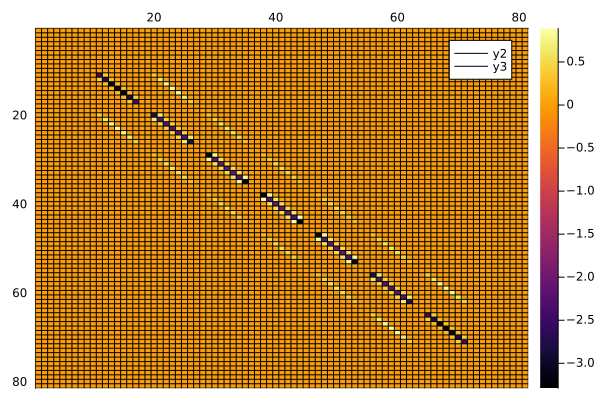

In [136]:
xs = [i for i = 1:size(A)[1]]
ys = [i for i = 1:size(A)[2]]
#z = float((1:4) * reshape(1:10, 1, :))
p = plot()
# hm = heatmap(xs, ys, A,xmirror = true,  yflip = true)#yflip = true)
heatmap!(xs, ys, A,xmirror = true,  yflip = true, fmt=:png)
#plot(hm,xguide = "x", yguide = "y", xmirror = true,  yflip = true)
mm, nn = size(A)
vline!(0.5:(nn+0.5), c=:black)
hline!(0.5:(mm+0.5), c=:black)
display(p)

In [137]:
issymmetric(A)

true

So the FE Preconditioner is still symmetric even with the added term $w_i^x w_j^y \Phi^{n+1}$

In [138]:
#function FiniteElementPreconditioner!(X,B)
FEPreTAdvDiffLinMaps = ( x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, dt::Float64, nu::Float64) -> LinearMap((length(x))*(length(y)); issymmetric=true, ismutating=true) do Z,R
    
    N = length(x) - 1
    M = length(y) - 1
    Cijkl = zeros(Float64,(3,3))
    z = 0.0
    dtnu611 = - 6.0*dt*nu/11.0
    #one11 = 1.0/11.0

    @. Z = 0.0
    
    for j in 1:M-1 #do not do y boundaries
        jj = j+1
        for i in 1:N-1 #do not do x boundaries
            ii = i+1
            n = ii + (jj-1)*(N+1)
            z = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for l in -1:1
                ll=l+2
                for k in -1:1
                    #eqn 5.96
                    kk = k+2
                    nn = ii+k + (jj+l-1)*(N+1)
                    z = z + Cijkl[kk,ll] * R[nn]
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        
                        #A[n,nnn] = A[n,nnn] +  Cijkl[kk,ll]
                        #B[n] = B[n] + Cijkl[kk,ll] * U[nn]
                    # end

                end
            end
            # B[n] = B[n] + Cijkl[1,1] * U[ii-1 + (jj-1-1)*(N+1)] + Cijkl[2,1] + U[ii-0 + (jj-1-1)*(N+1)]+ Cijkl[3,1] * U[ii+1 + (jj-1-1) * (N+1)] + Cijkl[1,2] * U[ii-1 + (jj-0-1)*(N+1)] + Cijkl[2,2] * U[ii-0 + (jj-0-1)*(N+1)] + Cijkl[3,2] * U[ii+1 + (jj-0-1)*(N+1)] + Cijkl[1,3] * U[ii-1 + (jj+1-1)*(N+1)] + Cijkl[2,3] * U[ii-0 + (jj+1-1)*(N+1)] + Cijkl[3,3] * U[ii+1 + (jj+1-1)*(N+1)]
            Z[n] = wx[ii]*wy[jj]*R[n] + dtnu611*z

        end
    end
    return Z

end

#133 (generic function with 1 method)

We can also use the  LinearOperators.jl package:

In [139]:
#FE Preconditioner with LinearOperators.jl
FEpreTAdvDiffLinOp = ( x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, dt::Float64, nu::Float64) -> (Z,R, alpha, beta) -> begin
    
    N = length(x) - 1
    M = length(y) - 1
    Cijkl = zeros(Float64,(3,3))
    z = 0.0
    dtnu611 = - 6.0*dt*nu/11.0
    #one11 = 1.0/11.0

    @. Z = 0.0
    
    for j in 1:M-1 #do not do y boundaries
        jj = j+1
        for i in 1:N-1 #do not do x boundaries
            ii = i+1
            n = ii + (jj-1)*(N+1)
            z = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for l in -1:1
                ll=l+2
                for k in -1:1
                    #eqn 5.96
                    kk = k+2
                    nn = ii+k + (jj+l-1)*(N+1)
                    z = z + Cijkl[kk,ll] * R[nn]
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        
                        #A[n,nnn] = A[n,nnn] +  Cijkl[kk,ll]
                        #B[n] = B[n] + Cijkl[kk,ll] * U[nn]
                    # end

                end
            end
            # B[n] = B[n] + Cijkl[1,1] * U[ii-1 + (jj-1-1)*(N+1)] + Cijkl[2,1] + U[ii-0 + (jj-1-1)*(N+1)]+ Cijkl[3,1] * U[ii+1 + (jj-1-1) * (N+1)] + Cijkl[1,2] * U[ii-1 + (jj-0-1)*(N+1)] + Cijkl[2,2] * U[ii-0 + (jj-0-1)*(N+1)] + Cijkl[3,2] * U[ii+1 + (jj-0-1)*(N+1)] + Cijkl[1,3] * U[ii-1 + (jj+1-1)*(N+1)] + Cijkl[2,3] * U[ii-0 + (jj+1-1)*(N+1)] + Cijkl[3,3] * U[ii+1 + (jj+1-1)*(N+1)]
            Z[n] = wx[ii]*wy[jj]*R[n] + dtnu611*z

        end
    end
    #return Z

end

#137 (generic function with 1 method)

To solve the preconditioner equation we use the single sweep SSOR. We can do it using LinearMaps.jl and LinearOperators.jl

In [140]:
#alg 79
#looks like we have to make this into a linear map
#function SSORSweep!(z::Array{Float64},r::Array{Float64}, omega::Float64, x::Array{Float64}, y::Array{Float64})
SSORSweepTAdvDiffLinMaps = ( x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, dt::Float64, nu::Float64, omega::Float64) -> LinearMap((length(x))*(length(y)); issymmetric=true,ismutating=true) do Z,R
    
    N = length(x)-1
    M = length(y)-1
    
    @. Z = 0.0
    s = 0.0
    Cijkl = zeros(Float64,(3,3))
    dtnu611 = -6.0*dt*nu/11.0

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            #Z[n] = 0.0
            s = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1)#ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            s = wx[ii]*wy[jj]*Z[n] + dtnu611*s
            Z[n] = Z[n] + omega * (R[n] - s)/(wx[ii]*wy[jj] + dtnu611*Cijkl[0+2,0+2])
        end
    end

    for j in M-1:-1:1
        jj=j+1
        for i in N-1:-1:1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            s=0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1) #ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            s = wx[ii]*wy[jj]*Z[n] + dtnu611*s
            Z[n] = Z[n] + omega * (R[n] - s)/(wx[ii]*wy[jj] + dtnu611*Cijkl[0+2,0+2])
        end
    end


    return Z   


end

#141 (generic function with 1 method)

In [141]:
#alg 79
#looks like we have to make this into a linear map
#function SSORSweep!(z::Array{Float64},r::Array{Float64}, omega::Float64, x::Array{Float64}, y::Array{Float64})
SSORSweepTAdvDiffLinOp = ( x::Array{Float64}, y::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, dt::Float64, nu::Float64, omega::Float64)->(Z,R,alpha,beta) -> begin
    
    N = length(x)-1
    M = length(y)-1
    
    @. Z = 0.0
    s = 0.0
    Cijkl = zeros(Float64,(3,3))
    dtnu611 = -6.0 * dt*nu/11.0

    for j in 1:M-1
        jj=j+1
        for i in 1:N-1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            #Z[n] = 0.0
            s = 0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1)#ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            s = wx[ii]*wy[jj]*Z[n] + dtnu611*s
            Z[n] = Z[n] + omega * (R[n] - s)/(wx[ii]*wy[jj] + dtnu611*Cijkl[0+2,0+2])
        end
    end

    for j in M-1:-1:1
        jj=j+1
        for i in N-1:-1:1
            ii = i+1
            n = ii + (jj-1)*(N+1)
            s=0.0
            Cijkl .= StencilCoefficients(i, j, x, y)
            for k in -1:1
                for l in -1:1
                    # if i+k>=1 && j+l >=1 && i+k<=N-1 && j+l<=M-1
                        nn = (i+k)+1 + (j+l+1-1)*(N+1) #ii+k + (jj+l-1)*(N+1)
                        s = s + Cijkl[k+2,l+2]*Z[nn]
                    # end
                end
            end
            s = wx[ii]*wy[jj]*Z[n] + dtnu611*s
            Z[n] = Z[n] + omega * (R[n] - s)/(wx[ii]*wy[jj] + dtnu611*Cijkl[0+2,0+2])
        end
    end



end

#145 (generic function with 1 method)

#### Benchmarking

#### No Preconditioner

In [142]:
u(x) = 0.8
v(y) = 0.8

phian(x,y,t, u,v, nu, x0, y0) = 1.0/(4.0*t +1.0 ) * exp(-( (x -u(x) *t -x0)^2 + (y -v(y) *t -y0)^2) / ( nu*(4.0*t + 1) ))

phian (generic function with 1 method)

In [143]:
#initial conditions
x0 = -0.5
y0 = -0.5
nu = 0.01
dt = 3.0e-4

nn = 28
N = nn
M = nn

28

In [144]:

xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
wb = BarycentricWeights(xyleg)

tstart = 0.0

p0 = [phian(xyleg[i],xyleg[j],tstart, u,v, nu, x0, y0) for i in 1:N+1, j in 1:M+1]
p1= deepcopy(p0);

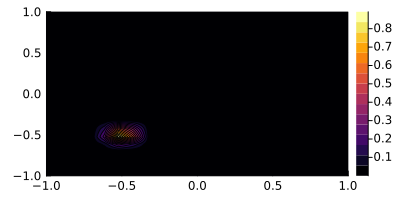

In [145]:
pcont = contour(xyleg,xyleg, p0, fill = true)
plot(pcont, format=:png, size=(400,200))

In [146]:
#LinearMaps
#laplacian operator matrix free
cnglapoplm = CNGLapOperatorLinMaps(xyleg, xyleg, wleg, wleg,wb, wb)
#transport operator
cngtranoplm = GalTranOpLinMaps(xyleg, xyleg, wleg, wleg,wb, wb, u, v) 

#LinearOperators
#laplacian operator matrix free
cnglapoplo = CNGLapOperatorLinOp(xyleg, xyleg, wleg, wleg,wb, wb)
cnglapoplinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> cnglapoplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

cngtranoplo = GalTranOpLinOp(xyleg, xyleg, wleg, wleg,wb, wb, u, v) 
cngtranoplinop =  LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> cngtranoplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

Linear operator
  nrow: 841
  ncol: 841
  eltype: Float64
  symmetric: true
  hermitian: false
  nprod:   0
  ntprod:  0
  nctprod: 0



In [147]:
cnglapoplm 

841×841 FunctionMap{Float64,true}(#44; issymmetric=false, ishermitian=false, isposdef=false)

In [148]:
typeof(cngtranoplinop )

LinearOperator{Float64, Int64, var"#153#154", Nothing, Nothing, Vector{Float64}}

In [149]:
#need to create our struct for the potential
#mutablestruct in order to hold the Phi from two previous time steps
# mutable struct Phin{P1,P2,P3,P4}
#     p1::P1
#     p2::P2
#     p3::P3
#     p4::P4
# end
P = Phin(zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)),  vec(p1));

In [150]:
#calculate first 2 steps withe xplicit RK3
# InitGallerkinStepRK3!(tn::Float64, dt::Float64, nu::Float64,  Phi::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, LAP::FunctionMap{Float64}, TRAN::FunctionMap{Float64})
InitGallerkinStepRK3!(0.0, dt, nu, P.p4,P.p3, wleg, wleg, cnglapoplm  ,cngtranoplm)
InitGallerkinStepRK3!(dt, dt, nu, P.p3,P.p2, wleg, wleg, cnglapoplm  ,cngtranoplm)

In [151]:
P.p2[1]

1.9287498479639178e-22

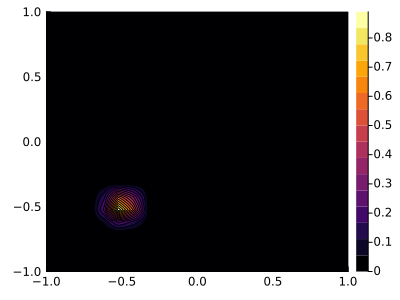

In [152]:
pcont = contour(xyleg,xyleg, P.p3, fill = true)
plot(pcont, format=:png, size=(400,300))

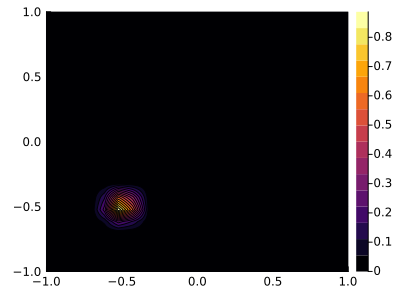

In [153]:
pcont = contour(xyleg,xyleg, P.p2, fill = true)
plot(pcont, format=:png, size=(400,300))

Now we need to write a solver since the RHS changes over time

In [154]:
#struct for preconditioner
struct CNGPreConditioner{F,Finv}
	fun::F
    finv::Finv
end


In [155]:
function GalerkinSolveDiffAdv!(Nt::Int64, dt::Float64, phi::Phin,wx::Array{Float64}, wy::Array{Float64}, LHSLAP::LinearOperator{Float64}, RHSTRAN::FunctionMap{Float64}, pc::CNGPreConditioner) #, x::Array{Float64}, y::Array{Float64},  wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64})

    RHS = zeros(Float64, length(phi.p1))
    

    for n in 1:Nt
        #make RHS vector
        #RHSIMEX3Galerkin!(rhs::Array{Float64},phi::Phin, wx::Array{Float64}, wy::Array{Float64}, dt::Float64,  qD::FunctionMap{Float64})
        RHSIMEX3Galerkin!(RHS,phi, wx, wy, dt,  RHSTRAN)
        #solve Ax =b
        (phi.p1, stats) = Krylov.cg(LHSLAP, RHS, P.p2)#, M=pc, ldiv=true)#bicgstabl(LHSLAP, RHS,Pl=pc, max_mv_products=400)
        #push phi^n
        phi.p4 .= phi.p3
        phi.p3 .= phi.p2
        phi.p2 .= phi.p1

        #print stats every 10 steps
        if mod(n,10) == 0
            println("Step: ", n)
            println("-------------")
            println(stats)
        end


    end
    

    return nothing
    
end

GalerkinSolveDiffAdv! (generic function with 1 method)

In [156]:
#let's increase dt
#dt = 3.0e-4
dt = 10.0*dt
t_total = 0.5
nt = ceil(Int64, t_total/dt)

167

In [157]:
nt*0.1465

24.4655

Now we set up for the IMEX3 calculation. We need the LHS Matrix-Free Operator

In [158]:
#linearmaps
#Galerkin LHS Operator
GallhsLM = LHSGalerkinMaps(N, M, wleg, wleg, nu, dt, cnglapoplm) 
#preconditioner operator matrix free 
feprelm = FEPreTAdvDiffLinMaps( xyleg,xyleg, wleg, wleg, dt, nu)
#Preconditioner solver
feprelmsolve = SSORSweepTAdvDiffLinMaps = (xyleg,xyleg, wleg, wleg, dt, nu, 1.4)

#LinearOperators
#LHS Operator
GalLHSLO = LHSGalerkinLinOp(N, M, wleg, wleg, nu, dt, cnglapoplinop)
GalLHSlinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> GalLHSLO(res, v, 1.0, 0.0),
                     nothing,
                     nothing)
#preconditioner operator matrix free 
feplo = FEpreTAdvDiffLinOp( xyleg,xyleg, wleg, wleg, dt, nu) 
feplinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> feplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)
#Preconditioner solver
feplosolve = SSORSweepTAdvDiffLinOp( xyleg,xyleg, wleg, wleg, dt, nu, 1.4)
feplinopsolve = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> feplosolve(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

Linear operator
  nrow: 841
  ncol: 841
  eltype: Float64
  symmetric: true
  hermitian: false
  nprod:   0
  ntprod:  0
  nctprod: 0



In [159]:
#create preconditioner struct with linearmaps operators
PClinmap =CNGPreConditioner(feprelm,feprelmsolve);
#create preconditioner struct with linearoperators
PClinop =CNGPreConditioner(feplinop,feplinopsolve);

In [160]:
# using LinearAlgebra
#need to define matrix inverse multiplication A^-1 * x for the preconditioner
#we will use the bicstabl method to solve the preconditioner inverse matrix problem
LinearAlgebra.ldiv!(Y, P::CNGPreConditioner , X) = Y.= P.finv * X#bicgstabl(P.fun, X, max_mv_products=400)
LinearAlgebra.ldiv!(P::CNGPreConditioner, X) = X.= P.finv * X


In [161]:
#cnglapoplm
GalerkinSolveDiffAdv!(nt, dt,P,wleg, wleg, GalLHSlinop, cngtranoplm, PClinop) 

Step: 10
-------------
SimpleStats
 niter: 8
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 162.46ms
 status: solution good enough given atol and rtol

Step: 20
-------------
SimpleStats
 niter: 9
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 180.80ms
 status: solution good enough given atol and rtol

Step: 30
-------------
SimpleStats
 niter: 8
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 162.39ms
 status: solution good enough given atol and rtol

Step: 40
-------------
SimpleStats
 niter: 8
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 162.44ms
 status: solution good enough given atol and rtol

Step: 50
-------------
SimpleStats
 niter: 7
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 144.46ms
 status: solution good enough given atol and rtol

Step: 60
-------------
SimpleStats
 niter: 7
 solv

In [164]:
sol = zeros(Float64, (N+1,M+1))
for i in 1:N+1
    for j in 1:M+1
        nn = i + (j-1)*(N+1)
        sol[i,j] = P.p1[nn]
    end
end

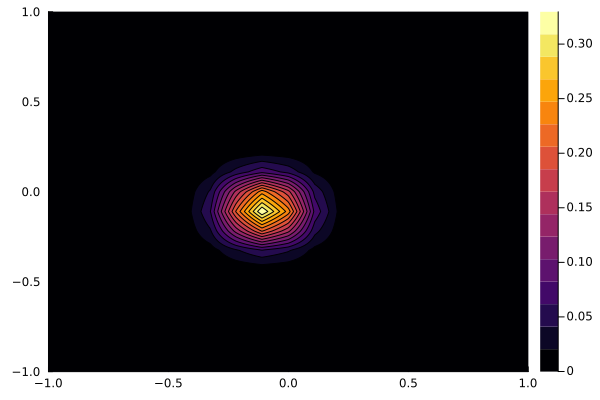

In [165]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

#### Now Interpolate to Square

In [168]:
Nout = 40
X = [-1+2*j/Nout for j in 0:Nout]
Y = [-1+2*j/Nout for j in 0:Nout]
# ww = BarycentricWeights(x)
# T = PolynomialInterpolationMatrix(x,X, ww,1.0e-9)
# Phiout = T*Phi

phiout = CoarseToFineInterpolation2Da(xyleg,  xyleg, sol,X,Y,1.0e-9);

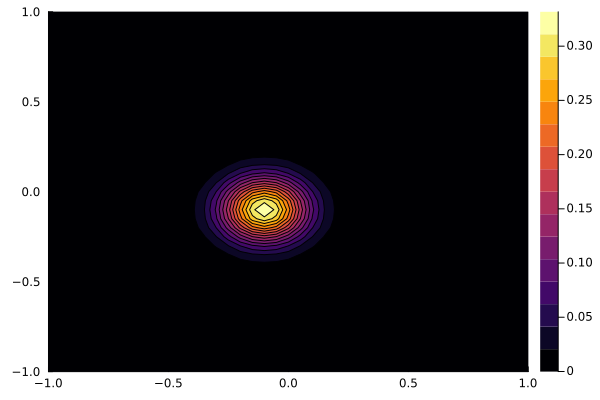

In [169]:
pcont = contour(X,Y, phiout, fill = true)
plot(pcont, format=:png)

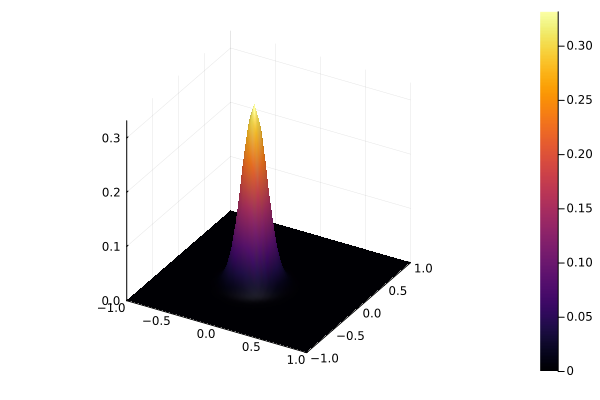

In [170]:
surf = surface(X,Y,phiout)
plot(surf, format=:png)

#### With Preconditioner

In [171]:
u(x) = 0.8
v(y) = 0.8

phian(x,y,t, u,v, nu, x0, y0) = 1.0/(4.0*t +1.0 ) * exp(-( (x -u(x) *t -x0)^2 + (y -v(y) *t -y0)^2) / ( nu*(4.0*t + 1) ))

phian (generic function with 1 method)

In [172]:
#initial conditions
x0 = -0.5
y0 = -0.5
nu = 0.01
dt = 3.0e-4

nn = 28
N = nn
M = nn

28

In [173]:

xyleg, wleg = LegendreGaussLobattoNodesAndWeights(nn, 100000, 1.0e-9);
wb = BarycentricWeights(xyleg)

tstart = 0.0

p0 = [phian(xyleg[i],xyleg[j],tstart, u,v, nu, x0, y0) for i in 1:N+1, j in 1:M+1]
p1= deepcopy(p0);

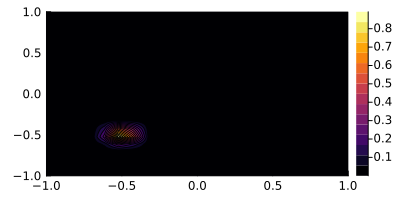

In [174]:
pcont = contour(xyleg,xyleg, p0, fill = true)
plot(pcont, format=:png, size=(400,200))

In [175]:
#LinearMaps
#laplacian operator matrix free
cnglapoplm = CNGLapOperatorLinMaps(xyleg, xyleg, wleg, wleg,wb, wb)
#transport operator
cngtranoplm = GalTranOpLinMaps(xyleg, xyleg, wleg, wleg,wb, wb, u, v) 

#LinearOperators
#laplacian operator matrix free
cnglapoplo = CNGLapOperatorLinOp(xyleg, xyleg, wleg, wleg,wb, wb)
cnglapoplinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> cnglapoplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

cngtranoplo = GalTranOpLinOp(xyleg, xyleg, wleg, wleg,wb, wb, u, v) 
cngtranoplinop =  LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> cngtranoplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

Linear operator
  nrow: 841
  ncol: 841
  eltype: Float64
  symmetric: true
  hermitian: false
  nprod:   0
  ntprod:  0
  nctprod: 0



In [176]:
cnglapoplm 

841×841 FunctionMap{Float64,true}(#44; issymmetric=false, ishermitian=false, isposdef=false)

In [177]:
typeof(cngtranoplinop )

LinearOperator{Float64, Int64, var"#173#174", Nothing, Nothing, Vector{Float64}}

In [178]:
#need to create our struct for the potential
#mutablestruct in order to hold the Phi from two previous time steps
# mutable struct Phin{P1,P2,P3,P4}
#     p1::P1
#     p2::P2
#     p3::P3
#     p4::P4
# end
P = Phin(zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)), zeros(Float64, (N+1)*(M+1)),  vec(p1));

In [179]:
#calculate first 2 steps withe xplicit RK3
# InitGallerkinStepRK3!(tn::Float64, dt::Float64, nu::Float64,  Phi::Array{Float64}, wx::Array{Float64}, wy::Array{Float64}, LAP::FunctionMap{Float64}, TRAN::FunctionMap{Float64})
InitGallerkinStepRK3!(0.0, dt, nu, P.p4,P.p3, wleg, wleg, cnglapoplm  ,cngtranoplm)
InitGallerkinStepRK3!(dt, dt, nu, P.p3,P.p2, wleg, wleg, cnglapoplm  ,cngtranoplm)

In [180]:
P.p2[1]

1.9287498479639178e-22

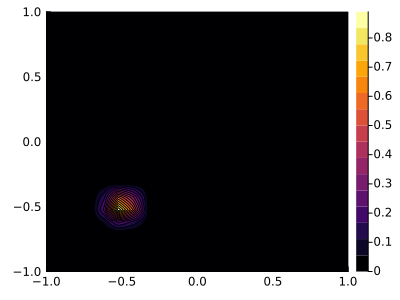

In [181]:
pcont = contour(xyleg,xyleg, P.p3, fill = true)
plot(pcont, format=:png, size=(400,300))

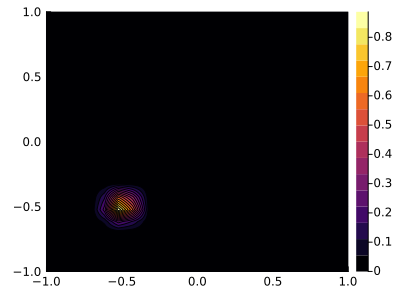

In [182]:
pcont = contour(xyleg,xyleg, P.p2, fill = true)
plot(pcont, format=:png, size=(400,300))

In [183]:
#struct for preconditioner
struct CNGPreConditioner{F,Finv}
	fun::F
    finv::Finv
end

In [184]:
function GalerkinSolveDiffAdv!(Nt::Int64, dt::Float64, phi::Phin,wx::Array{Float64}, wy::Array{Float64}, LHSLAP::LinearOperator{Float64}, RHSTRAN::FunctionMap{Float64}, pc::CNGPreConditioner) #, x::Array{Float64}, y::Array{Float64},  wx::Array{Float64}, wy::Array{Float64}, wbx::Array{Float64}, wby::Array{Float64})

    RHS = zeros(Float64, length(phi.p1))
    

    for n in 1:Nt
        #make RHS vector
        #RHSIMEX3Galerkin!(rhs::Array{Float64},phi::Phin, wx::Array{Float64}, wy::Array{Float64}, dt::Float64,  qD::FunctionMap{Float64})
        RHSIMEX3Galerkin!(RHS,phi, wx, wy, dt,  RHSTRAN)
        #solve Ax =b
        (phi.p1, stats) = Krylov.cg(LHSLAP, RHS, P.p2, M=pc, ldiv=true)#bicgstabl(LHSLAP, RHS,Pl=pc, max_mv_products=400)
        #push phi^n
        phi.p4 .= phi.p3
        phi.p3 .= phi.p2
        phi.p2 .= phi.p1

        #print stats every 10 steps
        if mod(n,10) == 0
            println("Step: ", n)
            println("-------------")
            println(stats)
        end


    end
    

    return nothing
    
end

GalerkinSolveDiffAdv! (generic function with 1 method)

In [185]:
#let's increase dt
#dt = 3.0e-4
dt = 10.0*dt
t_total = 0.5
nt = ceil(Int64, t_total/dt)

167

In [186]:
dt

0.0029999999999999996

In [187]:
nt*0.1465

24.4655

Now we set up for the IMEX3 calculation. We need the LHS Matrix-Free Operator

In [188]:
#linearmaps
#Galerkin LHS Operator
GallhsLM = LHSGalerkinMaps(N, M, wleg, wleg, nu, dt, cnglapoplm) 
#preconditioner operator matrix free 
feprelm = FEPreTAdvDiffLinMaps( xyleg,xyleg, wleg, wleg, dt, nu)
#Preconditioner solver
feprelmsolve = SSORSweepTAdvDiffLinMaps = (xyleg,xyleg, wleg, wleg, dt, nu, 1.4)

#LinearOperators
#LHS Operator
GalLHSLO = LHSGalerkinLinOp(N, M, wleg, wleg, nu, dt, cnglapoplinop)
GalLHSlinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> GalLHSLO(res, v, 1.0, 0.0),
                     nothing,
                     nothing)
#preconditioner operator matrix free 
feplo = FEpreTAdvDiffLinOp( xyleg,xyleg, wleg, wleg, dt, nu) 
feplinop = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> feplo(res, v, 1.0, 0.0),
                     nothing,
                     nothing)
#Preconditioner solver
feplosolve = SSORSweepTAdvDiffLinOp( xyleg,xyleg, wleg, wleg, dt, nu, 1.4)
feplinopsolve = LinearOperator(Float64, (N+1)*(M+1), (N+1)*(M+1), true, false,
                     (res, v) -> feplosolve(res, v, 1.0, 0.0),
                     nothing,
                     nothing)

Linear operator
  nrow: 841
  ncol: 841
  eltype: Float64
  symmetric: true
  hermitian: false
  nprod:   0
  ntprod:  0
  nctprod: 0



In [189]:
#create preconditioner struct with linearmaps operators
PClinmap =CNGPreConditioner(feprelm,feprelmsolve);
#create preconditioner struct with linearoperators
PClinop =CNGPreConditioner(feplinop,feplinopsolve);

In [190]:
# using LinearAlgebra
#need to define matrix inverse multiplication A^-1 * x for the preconditioner
#we will use the bicstabl method to solve the preconditioner inverse matrix problem
LinearAlgebra.ldiv!(Y, P::CNGPreConditioner , X) = Y.= P.finv * X#bicgstabl(P.fun, X, max_mv_products=400)
LinearAlgebra.ldiv!(P::CNGPreConditioner, X) = X.= P.finv * X


In [191]:
#cnglapoplm
GalerkinSolveDiffAdv!(nt, dt,P,wleg, wleg, GalLHSlinop, cngtranoplm, PClinop) 

Step: 10
-------------
SimpleStats
 niter: 5
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 215.45ms
 status: solution good enough given atol and rtol

Step: 20
-------------
SimpleStats
 niter: 5
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 219.68ms
 status: solution good enough given atol and rtol

Step: 30
-------------
SimpleStats
 niter: 5
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 192.96ms
 status: solution good enough given atol and rtol

Step: 40
-------------
SimpleStats
 niter: 5
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 192.20ms
 status: solution good enough given atol and rtol

Step: 50
-------------
SimpleStats
 niter: 4
 solved: true
 inconsistent: false
 residuals: []
 Aresiduals: []
 κ₂(A): []
 timer: 160.40ms
 status: solution good enough given atol and rtol

Step: 60
-------------
SimpleStats
 niter: 5
 solv

In [192]:
sol = zeros(Float64, (N+1,M+1))
for i in 1:N+1
    for j in 1:M+1
        nn = i + (j-1)*(N+1)
        sol[i,j] = P.p1[nn]
    end
end

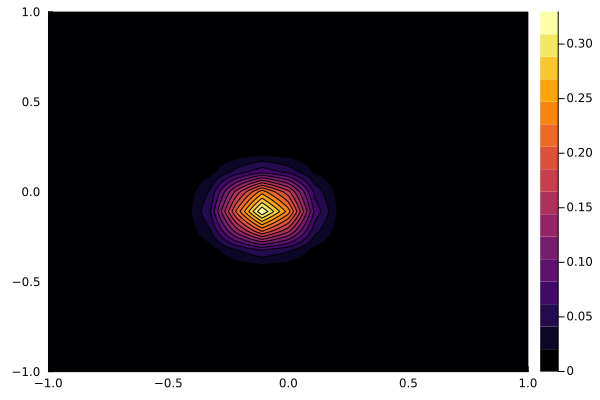

In [193]:
pcont = contour(xyleg,xyleg, sol, fill = true)
plot(pcont, format=:png)

#### Now Interpolate to Square

In [250]:
Nout = 40
X = [-1+2*j/Nout for j in 0:Nout]
Y = [-1+2*j/Nout for j in 0:Nout]
# ww = BarycentricWeights(x)
# T = PolynomialInterpolationMatrix(x,X, ww,1.0e-9)
# Phiout = T*Phi

phiout = CoarseToFineInterpolation2Da(xyleg,  xyleg, sol,X,Y,1.0e-9);

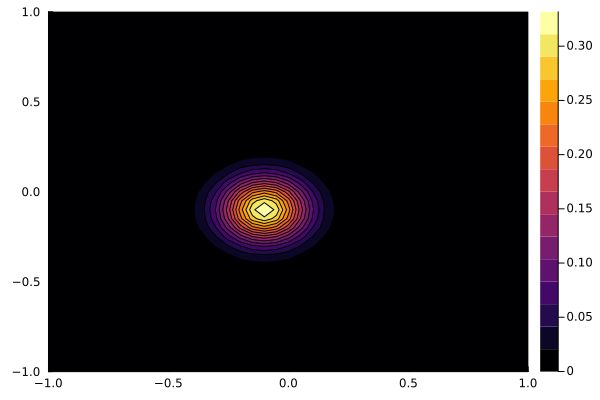

In [251]:
pcont = contour(X,Y, phiout, fill = true)
plot(pcont, format=:png)

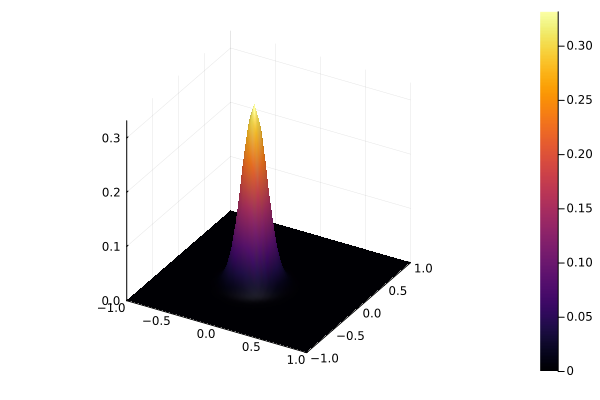

In [196]:
surf = surface(X,Y,phiout)
plot(surf, format=:png)

# 5.4 Approximating Wave Propagation Problems

Wave Equation:

\begin{align}
    \frac{\partial^2 }{\partial t^2} p - c^2 \left( p_{xx} + p_{yy} \right) = 0
    \tag{5.124}
\end{align}

We convert this into a system of 1st order PDEs:

\begin{align}
    u_t &= -p_x\\
    v_t &= -p_y
    \tag{5.125}
\end{align}

If the order of mixed partial derivatives doesn't matter then:

\begin{align}
    \frac{\partial^2}{\partial t^2} p + c^2 \left( ( u_x )_t + ( v_y )_t \right) = 0
    \tag{5.126}
\end{align}

With proper initial conditions:

\begin{align}
    \frac{\partial}{\partial t} p + c^2 \left( u_x  + v_y  \right) =0 
    \tag{5.127}
\end{align}


\begin{align}
    \left[ \begin{array}{cc} 
        p \\
        u \\ 
        v
    \end{array} \right]_t + \left[ \begin{array}{cc} 
        0 & c^2 & 0\\
        1 & 0 & 0 \\ 
        0 & 0 & 0 
    \end{array} \right] \left[ \begin{array}{cc} 
        p \\
        u \\ 
        v
    \end{array} \right]_x + \left[ \begin{array}{cc} 
        0 & 0 & c^2 \\
        0 & 0 & 0 \\ 
        1 & 0 & 0 
    \end{array} \right] \left[ \begin{array}{cc} 
        p \\
        u \\ 
        v
    \end{array} \right]_y = 0
    \tag{5.128}
\end{align}

Or in vector notation:

\begin{align}
    \bar{q}_t + \underline{B} \bar{q}_x + \underline{C} \bar{q}_y
    \tag{5.129}
\end{align}

And since $ \underline{B}$ and $\underline{C}$ are constants:

\begin{align}
    \bar{q}_t +  \bar{f}_x + \bar{g}_y
    \tag{5.130}
\end{align}


This is known as the divergence or conservation law:

\begin{align}
    \bar{q}_t + \nabla \cdot F = 0
    \tag{5.131}
\end{align}

with a vector flux:

\begin{align}
     F = \bar{f} \: \hat{x} + \bar{g} \: \hat{y}
\end{align}

# 5.4 The Nodal Discontinuous Galerkin Approximation

There's a lot of equations in this section so please be sure to refer back to the textbook

## 5.4.2 How to Implement Nodal Discontinuous Galerkin Approximation

In [197]:
#alg 90
#ch 5.4.2 pg 213
#Struct holding the 2D NDG variables
mutable struct NDG2DWaves

    
    
    N::Int64 # total points -1 in x-direction
    M::Int64 # total points -1 in y-direction
    x::Vector{Float64} #Gauss (lobatto) points in x
    y::Vector{Float64} #Gauss (lobatto) points in y
    wx::Vector{Float64} #Gauss (lobatto) weights in x
    wy::Vector{Float64} #Gauss (lobatto) weights in y
    wbx::Vector{Float64} #barrycentric weights in x
    wby::Vector{Float64} #barrycentric weights in y

    Dhatx::Matrix{Float64} #First derivative matrix in x
    Dhaty::Matrix{Float64} #First derivative matrix in y

    Q1::Matrix{Float64} #p in eqn 5.128
    Q2::Matrix{Float64} #u in eqn 5.128
    Q3::Matrix{Float64} #v in eqn 5.128

    dQ1::Matrix{Float64} #p in eqn 5.128
    dQ2::Matrix{Float64} #u in eqn 5.128
    dQ3::Matrix{Float64} #v in eqn 5.128

    Fx::Matrix{Float64} #p flux in eqn 5.128
    Fy::Matrix{Float64} #p flux in eqn 5.128
    # F2::Matrix{Float64} #u flux in eqn 5.128
    # F3::Matrix{Float64} #v flux in eqn 5.128

    
    dFx::Matrix{Float64}
    dFy::Matrix{Float64}
    # dF1x::Vector{Float64} #derivative of p x flux in eqn 5.128
    # dF2x::Vector{Float64} #derivative of u x flux in eqn 5.128
    # dF3x::Vector{Float64} #derivative of v x flux in eqn 5.128
    # dF1y::Vector{Float64} #derivative of p y flux in eqn 5.128
    # dF2y::Vector{Float64} #derivative of u y flux in eqn 5.128
    # dF3y::Vector{Float64} #derivative of v y flux in eqn 5.128

    FR::Vector{Float64}
    FL::Vector{Float64}
    # FRx::Vector{Float64}
    # FRy::Vector{Float64}
    # FLx::Vector{Float64}
    # FLy::Vector{Float64}
    # F1Rx::Vector{Float64} #p x flux from right
    # F1Lx::Vector{Float64} #p x flux from left
    # F2Rx::Vector{Float64} #u x flux from right
    # F2Lx::Vector{Float64} #u x flux from left
    # F3Rx::Vector{Float64} #v x flux from right
    # F3Lx::Vector{Float64} #v x flux from left
    # F1Ry::Vector{Float64} #p y flux from right
    # F1Ly::Vector{Float64} #p y flux from left
    # F2Ry::Vector{Float64} #u y flux from right
    # F2Ly::Vector{Float64} #u y flux from left
    # F3Ry::Vector{Float64} #v y flux from right
    # F3Ly::Vector{Float64} #v y flux from left

    QLint::Vector{Float64}
    QRint::Vector{Float64}
    QLext::Vector{Float64}
    QRext::Vector{Float64}
    # QLintx::Vector{Float64} #p x-flux left internal
    # QRintx::Vector{Float64} #p x-flux right internal
    # QLextx::Vector{Float64} #p x-flux left external
    # QRextx::Vector{Float64} #p x-flux right external
    # QLinty::Vector{Float64} #p y-flux left internal
    # QRinty::Vector{Float64} #p y-flux right internal
    # QLexty::Vector{Float64} #p y-flux left external
    # QRexty::Vector{Float64} #p y-flux right external

    c::Float64 #speed of wave
    n::Vector{Float64} #Normal Vector

    lp1x::Vector{Float64} #langrange interpolation at x=1 boundary
    ln1x::Vector{Float64} #langrange interpolation at x=-1 boundary
    lp1y::Vector{Float64} #langrange interpolation at y=1 boundary
    ln1y::Vector{Float64} #langrange interpolation at y=- boundary
    
    NDG2DWaves() = new()
    
    


end

We repurpose **Algorithm 59** to construct the Nodal Discontinuous Galerkin Variables and Functions

In [198]:
#alg 59B
#NodalDiscontinuousGalerkinConstruct
function NDGConstruct(NDG::NDG2DWaves, N::Int64, M::Int64, LegOrCheb::String, t::Float64, Fp::Function, Fu::Function, Fv::Function, c::Float64, k::Vector{Float64})
    #Inputs
    #NDGsystem - Struct containing all variables needed
    #N - Number of nodes from 0 to N in x-direction
    #M - Number of nodes from 0 to M in y-direction

    #set node points
    NDG.N = N
    NDG.M = M

    NDG.x, NDG.wx = LegendreGaussNodesAndWeights(N, 100000, 1e-9)
    NDG.y, NDG.wy = LegendreGaussNodesAndWeights(M, 100000, 1e-9)
    
    #barycentric weights
    NDG.wbx = BarycentricWeights(NDG.x)
    NDG.wby = BarycentricWeights(NDG.y)
    #interpolation coefficients for l_j(+-1)
    NDG.ln1x = LagrangeInterpolatingPolynomials(-1.0, NDG.x, NDG.wbx,1.0e-12)
    NDG.lp1x = LagrangeInterpolatingPolynomials(1.0, NDG.x, NDG.wbx,1.0e-12)
    NDG.ln1y = LagrangeInterpolatingPolynomials(-1.0, NDG.y, NDG.wby,1.0e-12)
    NDG.lp1y = LagrangeInterpolatingPolynomials(1.0, NDG.y, NDG.wby,1.0e-12)

    #derivative matrix
    Dx = PolynomialDerivativeMatrix(NDG.x)
    NDG.Dhatx = zeros(Float64, size(Dx))
    Dy = PolynomialDerivativeMatrix(NDG.y)
    NDG.Dhaty = zeros(Float64, size(Dy))
    #Dhattotal = zeros(Float64, (N+1,N+1))

    for j in 0:N
        jj=j+1
        for i in 0:N
            ii = i+1 
            NDG.Dhatx[ii,jj] = -Dx[jj,ii]*NDG.wx[jj]/NDG.wx[ii]
            #total Dhat with transpose
            #Dhattotal[jj,ii] = -(lp1[ii]*lp1[jj]  - D[ii,jj]*w[ii])/w[jj]
            #total Dhat without transpose
            # Dhattotal[ii,jj] = -(lp1[ii]*lp1[jj] - D[ii,jj]*w[jj]/w[ii])
        end
    end
    for j in 0:M
        jj=j+1
        for i in 0:M
            ii = i+1 
            NDG.Dhaty[ii,jj] = -Dy[jj,ii]*NDG.wy[jj]/NDG.wy[ii]
        end
    end

    #setting up other matrices
    NDG.Q1 = Fp.(NDG.x, transpose(NDG.y), t)#zeros(Float64, ((N+1),(M+1)))
    NDG.Q2 = Fu.(NDG.x,transpose(NDG.y), t)#zeros(Float64, ((N+1),(M+1)))
    NDG.Q3 = Fv.(NDG.x,transpose(NDG.y),t)#zeros(Float64, ((N+1),(M+1)))

    NDG.dQ1 = zeros(Float64, ((N+1),(M+1)))
    NDG.dQ2 = zeros(Float64, ((N+1),(M+1)))
    NDG.dQ3 = zeros(Float64, ((N+1),(M+1)))

    NDG.Fx =zeros(Float64, (N+1, 3))
    NDG.Fy =zeros(Float64, (M+1, 3))
    # NDG.F1 = zeros(Float64, ((N+1),(M+1)))
    # NDG.F2 = zeros(Float64, ((N+1),(M+1)))
    # NDG.F3 = zeros(Float64, ((N+1),(M+1)))

    NDG.dFx = zeros(Float64, (N+1, 3))
    # NDG.dF2x = zeros(Float64, N+1)
    # NDG.dF3x = zeros(Float64, N+1)
    NDG.dFy = zeros(Float64, (M+1, 3))
    # NDG.dF2y = zeros(Float64, M+1)
    # NDG.dF3y = zeros(Float64, M+1)

    NDG.FR = zeros(Float64,3)
    NDG.FL = zeros(Float64,3)
    # NDG.FRx = zeros(Float64,3)
    # NDG.F2Rx = zeros(Float64, N+1)
    # NDG.F3Rx = zeros(Float64, N+1)
    # NDG.FRy = zeros(Float64, 3)
    # NDG.F2Ry = zeros(Float64, M+1)
    # NDG.F3Ry = zeros(Float64, M+1)

    # NDG.FLx = zeros(Float64, 3)
    # NDG.F2Lx = zeros(Float64, N+1)
    # NDG.F3Lx = zeros(Float64, N+1)
    # NDG.FLy = zeros(Float64, 3)
    # NDG.F2Ly = zeros(Float64, M+1)
    # NDG.F3Ly = zeros(Float64, M+1)

    NDG.QRint = zeros(Float64, 3)
    NDG.QRext = zeros(Float64, 3)
    NDG.QLint = zeros(Float64, 3)
    NDG.QLext = zeros(Float64, 3)
    # NDG.QRintx = zeros(FLoat64,3)#zeros(Float64, (N+1, 3))
    # NDG.QRextx = zeros(FLoat64,3)#zeros(Float64, (N+1, 3))
    # NDG.QRinty = zeros(FLoat64,3)#zeros(Float64, (M+1, 3))
    # NDG.QRexty = zeros(FLoat64,3)#zeros(Float64, (M+1, 3))

    # NDG.QLintx = zeros(FLoat64,3)#zeros(Float64, ( N+1, 3))
    # NDG.QLextx = zeros(FLoat64,3)#zeros(Float64, (N+1, 3))
    # NDG.QLinty = zeros(FLoat64,3)#zeros(Float64, (M+1, 3))
    # NDG.QLexty = zeros(FLoat64,3)#zeros(Float64, (M+1, 3))

    #wave variables
    NDG.c = c
    NDG.n = k

    return nothing

end

NDGConstruct (generic function with 1 method)

In [199]:
#alg 88 
#ch 5.4.1.1 pg 
#Numerical Flux Reimann Solver for wave equation
function ReimannSolver(QL::Array{Float64}, QR::Array{Float64}, k::Array{Float64},n::Array{Float64}, c::Float64)

    nx = n[1]#*k[1]##*
    ny = n[2]#*k[2]#n[2]#*
    
    pL = QL[1]
    uL = QL[2]
    vL = QL[3]

    pR = QR[1]
    uR = QR[2]
    vR = QR[3]

    wLplus = pL + c*(nx*uL + ny*vL) #
    wRminus = pR - c*(nx*uR + ny*vR) #pR - c*(nx*uR + ny*vR)#

    # println("wLplus")

    F1 = c*(wLplus - wRminus)/2.0
    F2 = nx*(wLplus + wRminus)/2.0
    F3 = ny*(wLplus + wRminus)/2.0

    #F = [F1, F2, F3]

    return [F1, F2, F3]
    

end

ReimannSolver (generic function with 1 method)

In [200]:
#Alg 92
#Ch 5.4.2 pg 214
#using eqn 5.152
#Toatl system derivative
function SystemDGDerivative!(N::Int64, dF1::AbstractArray, dF2::AbstractArray, dF3::AbstractArray, F1::AbstractArray, F2::AbstractArray, F3::AbstractArray, Dhat::Array{Float64}, w::Array{Float64}, lp1::Array{Float64}, ln1::Array{Float64}, FL::Array{Float64}, FR::Array{Float64})
    #construct flux derivative

    NN = length(F1)
    dF1 .= Dhat * F1
    dF2 .= Dhat * F2
    dF3 .= Dhat * F3    
    # dF1 .= dF1 .+ (FR[1] * lp1 .+ FL[1] * ln1)./w 
    # dF2 .= dF2 .+ (FR[2] * lp1 .+ FL[2] * ln1)./w 
    # dF3 .= dF3 .+ (FR[3] * lp1 .+ FL[3] * ln1)./w 
        # NDG.dF2[:,j]  .= (NDG.F2R[:,j] * NDG.lp1[j] + NDG.F2L[:,j] * NDG.ln1[j]) ./wx + NDG.Dhatx * F2[:,j] 
        # NDG.dF3[:,j]  .= (NDG.F3R[:,j] * NDG.lp1[j] + NDG.F3L[:,j] * NDG.ln1[j]) ./wx + NDG.Dhatx * F3[:,j] 
    # end

    for i in 1:NN
    
        dF1[i] = dF1[i] + (FR[1]*lp1[i]  + FL[1]*ln1[i])/w[i]
        dF2[i] = dF2[i] + (FR[2]*lp1[i]  + FL[2]*ln1[i])/w[i]
        dF3[i] = dF3[i] + (FR[3]*lp1[i]  + FL[3]*ln1[i])/w[i]
    end

    return nothing


end

SystemDGDerivative! (generic function with 1 method)

In [405]:
#Alg 60 
# function ComputeDGDerivative(Phi::Array{Float64}, w::Array{Float64}, phiL::Float64, phiR::Float64, Dhat::Array{Float64}, Lp::Array{Float64}, Ln::Array{Float64})

#     NN = length(Phi)-1
#     dPhi = Dhat*Phi
    
#     for j in 0:NN
#         jj=j+1
#         #this is two dimensions so need to figure out how to convert this to 2D for phiR and phiL
#         dPhi[jj] = dPhi[jj] + (phiR * Lp[jj] - phiL * Ln[jj])/w[jj]
#         # dPhi[jj] = dPhi[jj] + (phiR * Lp[jj] - phiL * Ln[jj])/w[jj]
#     end

#     return dPhi
# end

We re-write **Algorithm 61** for the purpose of this problem

In [201]:
#alg 61a
function InterpolateToBoundary2D!(Phi::Array{Float64}, Lj::Array{Float64})

    N = length(Phi)
    interpolatedValue = 0.0

    for j in 0:N-1
        jj=j+1
        interpolatedValue = interpolatedValue + Phi[jj]*Lj[jj]
    end

    return interpolatedValue
end

#alg 64
function xFlux(Qn::Array{Float64}, c::Float64)

    F1 = c^2 * Qn[2]
    F2 =  Qn[1]
    F3 = 0.0 #c^2 * Qn[3]

    return F1, F2, F3

end

function yFlux(Qn::Array{Float64}, c::Float64)

    G1 = c^2 * Qn[3]
    G2 = 0.0 #c^2 * Qn[2]
    G3 = Qn[1]

    return G1, G2, G3

end


#alg 93
#Ch 5.4.2 pg 215
#Toatl system derivative
function DG2DTimeDerivative!(NDG::NDG2DWaves, t::Float64, ExternalState::Function)

    # QLint = zeros(Float64,3)
    # QRint = zeros(Float64,3)
    # QLext = zeros(Float64,3)
    # QRext = zeros(Float64,3)

    for j in 0:NDG.M
        jj=j+1
        
        NDG.QLint[1] = InterpolateToBoundary2D!(NDG.Q1[:,jj], NDG.ln1x)
        NDG.QRint[1] = InterpolateToBoundary2D!(NDG.Q1[:,jj], NDG.lp1x)
        NDG.QLint[2] = InterpolateToBoundary2D!(NDG.Q2[:,jj], NDG.ln1x)
        NDG.QRint[2] = InterpolateToBoundary2D!(NDG.Q2[:,jj], NDG.lp1x)
        NDG.QLint[3] = InterpolateToBoundary2D!(NDG.Q3[:,jj], NDG.ln1x)
        NDG.QRint[3] = InterpolateToBoundary2D!(NDG.Q3[:,jj], NDG.lp1x)

        #ExternalState must return a vector size 3 which are the external values at the boundary
        NDG.QLext .= ExternalState(NDG.QLint, -1.0, NDG.y[jj], t, "LEFT")
        NDG.QRext .= ExternalState(NDG.QRint, 1.0, NDG.y[jj], t, "RIGHT")
        # NDG.QLextx[:,1] = ExternalState(NDG.QLintx[:,1], -1, NDG.y[jj], t, "LEFT")
        # NDG.QLextx[:,2] = ExternalState(NDG.QLintx[:,2], -1, NDG.y[jj], t, "LEFT")
        # NDG.QLextx[:,3] = ExternalState(NDG.QLintx[:,3], -1, NDG.y[jj], t, "LEFT")
        # NDG.QRextx[:,1] = ExternalState(NDG.QRintx[:,1], 1, NDG.y[jj], t, "RIGHT")
        # NDG.QRextx[:,2] = ExternalState(NDG.QRintx[:,2], 1, NDG.y[jj], t, "RIGHT")
        # NDG.QRextx[:,3] = ExternalState(NDG.QRintx[:,3], 1, NDG.y[jj], t, "RIGHT")

        NDG.FL .= ReimannSolver(NDG.QLint, NDG.QLext, NDG.n, [-1.0, 0.0], NDG.c)
        NDG.FR .= ReimannSolver(NDG.QRint, NDG.QRext, NDG.n, [1.0, 0.0], NDG.c)
        # NDG.FL1x, NDG.FL2x, NDG.FL3x = ReimannSolver(NDG.QLintx, NDG.QLextx, [-1, 0], NDG.c)
        # NDG.FLx[1], NDG.FLx[2], NDG.FLx[3] = ReimannSolver(NDG.QLintx, NDG.QLextx, [-1, 0], NDG.c)
        # # NDG.FR1x, NDG.FR2x, NDG.FR3x = ReimannSolver(NDG.QRintx, NDG.QRextx, [1, 0], NDG.c)
        # NDG.FRx[1], NDG.FRx[2], NDG.FRx[3] = ReimannSolver(NDG.QRintx, NDG.QRextx, [1, 0], NDG.c)

        # for i in 0:NDG.N
        #     ii = i+1
        #     F[ii,jj] = xFlux(NDG.Q1,NDG.c)            
        # end
        #Don't need to use a for loop for
        #XFlux
        NDG.Fx[:,1] .= NDG.c^2 * NDG.Q2[:,jj]
        NDG.Fx[:,2] .= NDG.Q1[:,jj]
        NDG.Fx[:,3] .= 0.0

        # SystemDGDerivative!(NDG.N, NDG.dF1[:,jj], NDG.dF2[:,jj], NDG.dF3[:,jj], NDG.F1[:,jj], NDG.F2[:,jj], NDG.F3[:,jj], NDG.Dhatx, NDG.wx, NDG.lp1x, NDG.ln1x, FstarL1, FstarL2, FstarL3, FstarR1, FstarR2, FstarR3)
        SystemDGDerivative!(NDG.N, @view(NDG.dFx[:,1]), @view(NDG.dFx[:,2]), @view(NDG.dFx[:,3]), @view(NDG.Fx[:,1]), @view(NDG.Fx[:,2]), @view(NDG.Fx[:,3]), NDG.Dhatx, NDG.wx, NDG.lp1x, NDG.ln1x, NDG.FL, NDG.FR)

        NDG.dQ1[:,jj] .= -1.0*NDG.dFx[:,1]
        NDG.dQ2[:,jj] .= -1.0*NDG.dFx[:,2]
        NDG.dQ3[:,jj] .= -1.0*NDG.dFx[:,3]

    end

    for i in 0:NDG.N
        ii=i+1
        
        NDG.QLint[1] = InterpolateToBoundary2D!(NDG.Q1[ii,:], NDG.ln1y)
        NDG.QRint[1] = InterpolateToBoundary2D!(NDG.Q1[ii,:], NDG.lp1y)
        NDG.QLint[2] = InterpolateToBoundary2D!(NDG.Q2[ii,:], NDG.ln1y)
        NDG.QRint[2] = InterpolateToBoundary2D!(NDG.Q2[ii,:], NDG.lp1y)
        NDG.QLint[3] = InterpolateToBoundary2D!(NDG.Q3[ii,:], NDG.ln1y)
        NDG.QRint[3] = InterpolateToBoundary2D!(NDG.Q3[ii,:], NDG.lp1y)

        #ExternalState must return a vector size 3 which are the external values at the boundary
        NDG.QLext .= ExternalState(NDG.QLint, -1.0, NDG.x[ii], t, "BOTTOM")
        NDG.QRext .= ExternalState(NDG.QRint, 1.0, NDG.x[ii], t, "TOP")
        # NDG.QLextx[:,1] = ExternalState(NDG.QLintx[:,1], -1, NDG.y[jj], t, "LEFT")
        # NDG.QLextx[:,2] = ExternalState(NDG.QLintx[:,2], -1, NDG.y[jj], t, "LEFT")
        # NDG.QLextx[:,3] = ExternalState(NDG.QLintx[:,3], -1, NDG.y[jj], t, "LEFT")
        # NDG.QRextx[:,1] = ExternalState(NDG.QRintx[:,1], 1, NDG.y[jj], t, "RIGHT")
        # NDG.QRextx[:,2] = ExternalState(NDG.QRintx[:,2], 1, NDG.y[jj], t, "RIGHT")
        # NDG.QRextx[:,3] = ExternalState(NDG.QRintx[:,3], 1, NDG.y[jj], t, "RIGHT")

        NDG.FL .= ReimannSolver(NDG.QLint, NDG.QLext, NDG.n, [0.0 , -1.0], NDG.c)
        NDG.FR .= ReimannSolver(NDG.QRint, NDG.QRext, NDG.n, [0.0 , 1.0], NDG.c)
        # NDG.FL1x, NDG.FL2x, NDG.FL3x = ReimannSolver(NDG.QLintx, NDG.QLextx, [-1, 0], NDG.c)
        # NDG.FLx[1], NDG.FLx[2], NDG.FLx[3] = ReimannSolver(NDG.QLintx, NDG.QLextx, [-1, 0], NDG.c)
        # # NDG.FR1x, NDG.FR2x, NDG.FR3x = ReimannSolver(NDG.QRintx, NDG.QRextx, [1, 0], NDG.c)
        # NDG.FRx[1], NDG.FRx[2], NDG.FRx[3] = ReimannSolver(NDG.QRintx, NDG.QRextx, [1, 0], NDG.c)

        # for i in 0:NDG.N
        #     ii = i+1
        #     F[ii,jj] = xFlux(NDG.Q1,NDG.c)            
        # end
        #Don't need to use a for loop for
        #XFlux
        NDG.Fy[:,1] .= NDG.c^2 * NDG.Q3[ii,:]
        NDG.Fy[:,2] .= 0.0 
        NDG.Fy[:,3] .= NDG.Q1[ii,:]

        # SystemDGDerivative!(NDG.N, NDG.dF1[:,jj], NDG.dF2[:,jj], NDG.dF3[:,jj], NDG.F1[:,jj], NDG.F2[:,jj], NDG.F3[:,jj], NDG.Dhatx, NDG.wx, NDG.lp1x, NDG.ln1x, FstarL1, FstarL2, FstarL3, FstarR1, FstarR2, FstarR3)
        SystemDGDerivative!(NDG.M, @view(NDG.dFy[:,1]), @view(NDG.dFy[:,2]), @view(NDG.dFy[:,3]), @view(NDG.Fy[:,1]), @view(NDG.Fy[:,2]), @view(NDG.Fy[:,3]), NDG.Dhaty, NDG.wy, NDG.lp1y, NDG.ln1y, NDG.FL, NDG.FR)

        NDG.dQ1[ii,:] .= NDG.dQ1[ii,:] .- NDG.dFy[:,1]
        NDG.dQ2[ii,:] .= NDG.dQ2[ii,:] .- NDG.dFy[:,2]
        NDG.dQ3[ii,:] .= NDG.dQ3[ii,:] .- NDG.dFy[:,3]
    end

    
end

DG2DTimeDerivative! (generic function with 1 method)

We repurpose **Algorithm 62** for this problem

In [202]:
#alg 62
function DGStep2DByRK3!(NDG::NDG2DWaves,  G1::Array{Float64}, G2::Array{Float64}, G3::Array{Float64}, tn::Float64, dt::Float64, extstate::Function)

    am = [0.0; -5.0/9.0; -153.0/128.0]
    bm = [0.0; 1.0/3.0; 0.75]
    gm = [1.0/3.0; 15.0/16.0; 8.0/15.0]
    t = 0.0
    #N = length(Phi)
    #Phij = copy(Phi)
    #DPhi = zeros(Float64, size(Phi))
    #G = zeros(Float64, size(Phi))

    for m in 1:3
        t = tn +bm[m]*dt #update time
        #gt = g(t) #boundary condition in time
        #time derivative
        DG2DTimeDerivative!(NDG, t, extstate)#DGTimeDerivative(Phi,w, Dhat,gt, Lp, Ln,t, c)#D2*Phi

        #p
        # @. G = am[m]*G + DPhi
        @. G1 = am[m]*G1 + NDG.dQ1
        #@. Phi = Phi + gm[m] *dt *G
        @. NDG.Q1 = NDG.Q1 + gm[m] *dt *G1
        #u
        @. G2 = am[m]*G2 + NDG.dQ2
        @. NDG.Q2 = NDG.Q2 + gm[m] *dt *G2
        #v
        @. G3 = am[m]*G3 + NDG.dQ3
        @. NDG.Q3 = NDG.Q3 + gm[m] *dt *G3

    end
    #dirichlet boundary conditions
    # Phi[1] = 0.0
    # Phi[end] = 0.0

    return nothing

end

DGStep2DByRK3! (generic function with 1 method)

We repurpose previous driver for this problem

In [212]:
#alg 51d
function LegendreNodalDiscontinuousGalerkin2DWave!(NDG::NDG2DWaves, NT::Int64, dt::Float64, extfun::Function, Nout::Int64)

    #dt = Ttot/NT
    #N = Int(length(Phi)) - 1
    tn = 0.0
    #D2 = mthOrderPolynomialDerivativeMatrix(2, x)
    #D = CGDerivativeMatrix(N, x, w)
    #wb, ln1, lp1, D, Dhat, Dhattotal = NodalDiscontinuousGalerkinConstruct(N, x, w)
    G1 = zeros(Float64, size(NDG.Q1)) #DPhi
    G2 = zeros(Float64, size(NDG.Q2))
    G3 = zeros(Float64, size(NDG.Q3))
    for n in 0:NT-1
        IJulia.clear_output(true)
        println("Time Step: ",n)
        
        @. G1 = 0
        @. G2 = 0
        @. G3 = 0
        @. NDG.dQ1 = 0
        @. NDG.dQ2 = 0
        @. NDG.dQ3 = 0
        # DGStepByRK3!(Phi, w, Dhat,g, lp1, ln1, tn, dt, c)
        DGStep2DByRK3!(NDG, G1, G2, G3, tn, dt, extfun)
        tn = (n+1)*dt
        
        
    end

    X = [-1+2*j/Nout for j in 0:Nout]
    Y = [-1+2*j/Nout for j in 0:Nout]

    Q1out = CoarseToFineInterpolation2Da(NDG.x, NDG.y, NDG.Q1,X,Y,1.0e-9);
    Q2out = CoarseToFineInterpolation2Da(NDG.x, NDG.y, NDG.Q2,X,Y,1.0e-9);
    Q3out = CoarseToFineInterpolation2Da(NDG.x, NDG.y, NDG.Q3,X,Y,1.0e-9);

    return X, Y, Q1out, Q2out, Q3out
    
end

LegendreNodalDiscontinuousGalerkin2DWave! (generic function with 1 method)

## 5.4. Benchmark Solution: Plane Wave Propagation

Plane wave:

\begin{align}
    \left[ \begin{array}{cc}  
    p \\
    u \\
    v
    \end{array}\right] = \left[ \begin{array}{cc} 
    1 \\
    \frac{k_x}{c} \\
    \frac{k_y}{c}
    \end{array}\right]
    e^{ - \left( k_x (x - x_0) + k_y (y - y_0)  -c\: t^2 \right)/d^2 }
\end{align}

In [213]:
w = 0.2
d = w/(2*sqrt(log(2)))
c = 1.0
x0 = -0.8
y0 = -0.8
kx = sqrt(2)/2
ky= sqrt(2)/2
t0 = 0.0

Fp(x,y,t) = exp( -( kx*(x-x0) + ky*(y-y0) - c*t)^2 / d^2  )
Fu(x,y,t) = kx/c * exp( -( kx*(x-x0) + ky*(y-y0) - c*t)^2 / d^2  )
Fv(x,y,t) = ky/c * exp( -( kx*(x-x0) + ky*(y-y0) - c*t)^2 / d^2  )

Fv (generic function with 1 method)

In [214]:
N = 40
M = 40
dt = 2.6e-3

0.0026

initialize the NDG 2D struct

In [215]:
ndg = NDG2DWaves()

NDG2DWaves(140532107713824, 31920, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, 2.747e-320, #undef, #undef, #undef, #undef, #undef)

use `NDGConstruct()` to create all our variables, functions, and matrices

In [216]:
NDGConstruct(ndg, N, M, "Legendre", 0.0, Fp, Fu, Fv, c, [kx,ky])
#create a copy so we can go back to this original copy if necessary
ndg0 = deepcopy(ndg);

Let's check that our NDGConstruct worked. Let's see the speed `c`

In [217]:
ndg.c

1.0

In [218]:
ndg.n

2-element Vector{Float64}:
 0.7071067811865476
 0.7071067811865476

Let's plot the initial conditions

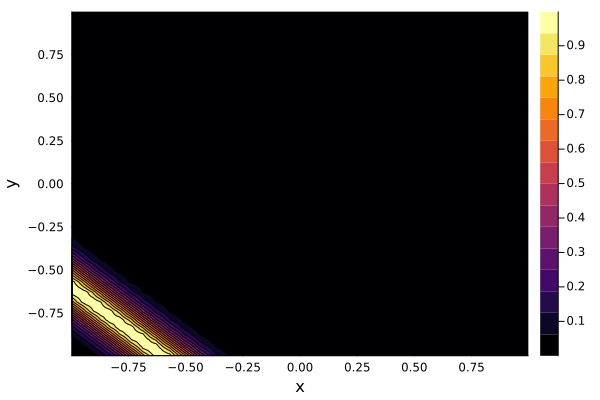

In [219]:
pcont = contour(ndg.x,ndg.y, transpose(ndg.Q1), fill = true)
plot(pcont, format=:png)
xlabel!("x")
ylabel!("y")

Now let's define our external free propagation functions

In [220]:
function ExtFunFreePropagation(Q::Array{Float64}, xyBoundary::Float64, xy::Float64, t::Float64, LRTB::String)

    Qext = zeros(Float64, 3)
    
    if LRTB=="LEFT" || LRTB== "RIGHT"
        Qext[1] = Fp(xyBoundary,xy,t)
        Qext[2] = Fu(xyBoundary,xy,t)
        Qext[3] = Fv(xyBoundary,xy,t)

    # elseif LRTB=="RIGHT"
    #     Qext[:,1] .= Fp.(xyBoundary,xy,t)
    #     Qext[:,2] .= Fu.(xyBoundary,xy,t)
    #     Qext[:,3] .= Fv.(xyBoundary,xy,t)

    elseif LRTB=="TOP" || LRTB== "BOTTOM"
        Qext[1] = Fp(xy,xyBoundary,t)
        Qext[2] = Fu(xy,xyBoundary,t)
        Qext[3] = Fv(xy,xyBoundary,t)

    # elseif LRTB=="BOTTOM"

    end
    return Qext
end

ExtFunFreePropagation (generic function with 1 method)

#### Simulation

Now let's actually simulate this

In [221]:
#copy the original initial conditions
ndg = deepcopy(ndg0);
dt = 2.0e-3
tend = 0.5
Nttot = ceil(Int64,tend/dt)

250

In [222]:
#begin simulation
xx, yy, PP, UU, VV = LegendreNodalDiscontinuousGalerkin2DWave!(ndg, Nttot, dt, ExtFunFreePropagation, 40);

Time Step: 249


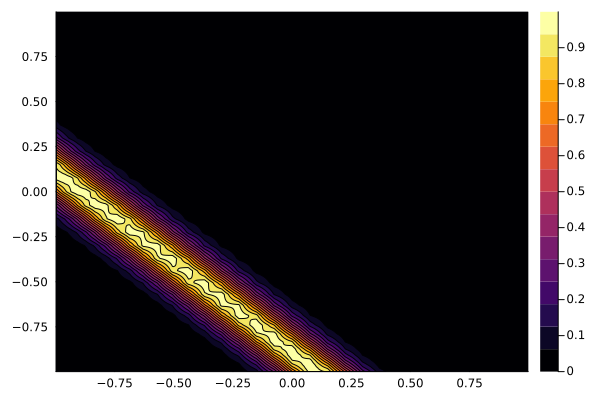

In [223]:
pcont = contour(ndg.x, ndg.y, ndg.Q1, fill = true)
plot(pcont, format=:png)

Let's look at the refined solution

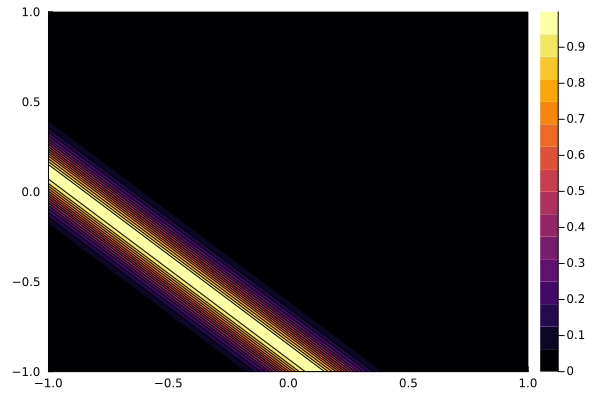

In [224]:
pcont = contour(xx,yy, transpose(PP), fill = true)
plot(pcont, format=:png)

# Problem 5.11

We will now try a problem from the text book which involves the same pulsed wave but with oscillations

Plane wave:

\begin{align}
    \left[ \begin{array}{cc}  
    p \\
    u \\
    v
    \end{array}\right] = \left[ \begin{array}{cc} 
    1 \\
    \frac{k_x}{c} \\
    \frac{k_y}{c}
    \end{array}\right]
    e^{ - \left( k_x (x - x_0) + k_y (y - y_0)  -c\: t^2 \right)/d^2 }
\end{align}

In [226]:
#assume coordinates are in meters
x0 = -0.5
y0 = -0.5

c = 1.0 #wave speed 1 m/s
lambda = 0.05 #wavelength 50 mm
K = 2.0*pi/lambda
kx = sqrt(K^2/2)#sqrt(2)/2
ky= sqrt(K^2/2)#sqrt(2)/2
t0 = 0.0

fwhmz = 3*lambda #fwhm in meters is 3 times wavelength
fwhmt = fwhmz/c #convert to time
tau = fwhmt/sqrt(2*log(2)) #gaussian tau

omega = c*K

Fp(x,y,t) = sin( omega *  (kx/omega*(x-x0) + ky/omega*(y-y0) - t))*exp( -(  kx/omega*(x-x0) + ky/omega*(y-y0) - t)^2 / tau^2  ) 
Fu(x,y,t) = sin( omega *  (kx/omega*(x-x0) + ky/omega*(y-y0) - t)) * kx/c * exp( -(  kx/omega*(x-x0) + ky/omega*(y-y0) - t)^2 / tau^2  )
Fv(x,y,t) = sin( omega *  (kx/omega*(x-x0) + ky/omega*(y-y0) - t)) * ky/c * exp( -(  kx/omega*(x-x0) + ky/omega*(y-y0) - t)^2 / tau^2  )

Fv (generic function with 1 method)

In [232]:
dx = lambda/6.0

N = ceil(Int64,2.0/dx)
M = N#200


240

In [233]:
ndg = NDG2DWaves()

NDG2DWaves(140534696517920, 140534855788640, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, #undef, 1.5544e-319, #undef, #undef, #undef, #undef, #undef)

In [234]:
NDGConstruct(ndg, N, M, "Legendre", 0.0, Fp, Fu, Fv, c, [kx,ky])
ndg0 = deepcopy(ndg);

In [235]:
ndg.c

1.0

In [236]:
ndg.n

2-element Vector{Float64}:
 88.85765876316732
 88.85765876316732

In [237]:
maximum(ndg.Q1)

0.990472090365813

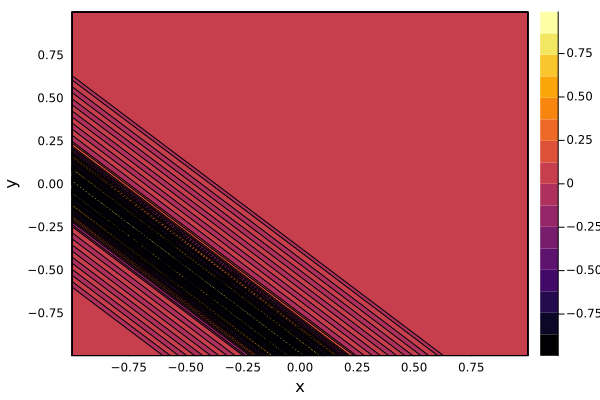

In [238]:
pcont = contour(ndg.x,ndg.y, transpose(ndg.Q1), fill = true)
plot(pcont, format=:png)
xlabel!("x")
ylabel!("y")

In [241]:
Nout = 350
X = [-1+2*j/Nout for j in 0:Nout]
Y = [-1+2*j/Nout for j in 0:Nout]

Q1out = CoarseToFineInterpolation2Da(ndg.x, ndg.y, ndg.Q1,X,Y,1.0e-9);
Q2out = CoarseToFineInterpolation2Da(ndg.x, ndg.y, ndg.Q2,X,Y,1.0e-9);
Q3out = CoarseToFineInterpolation2Da(ndg.x, ndg.y, ndg.Q3,X,Y,1.0e-9);

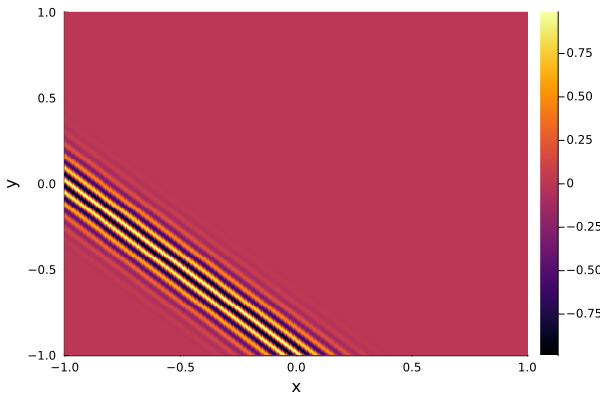

In [242]:
pcont = heatmap(X,Y, transpose(Q1out))#, fill = true)
plot(pcont, format=:png)#, xlim=(-0.5,0), ylim=(-0.5,0))
xlabel!("x")
ylabel!("y")

In [243]:
function ExtFunFreePropagation(Q::Array{Float64}, xyBoundary::Float64, xy::Float64, t::Float64, LRTB::String)

    Qext = zeros(Float64, 3)
    
    if LRTB=="LEFT" || LRTB== "RIGHT"
        Qext[1] = Fp(xyBoundary,xy,t)
        Qext[2] = Fu(xyBoundary,xy,t)
        Qext[3] = Fv(xyBoundary,xy,t)

    # elseif LRTB=="RIGHT"
    #     Qext[:,1] .= Fp.(xyBoundary,xy,t)
    #     Qext[:,2] .= Fu.(xyBoundary,xy,t)
    #     Qext[:,3] .= Fv.(xyBoundary,xy,t)

    elseif LRTB=="TOP" || LRTB== "BOTTOM"
        Qext[1] = Fp(xy,xyBoundary,t)
        Qext[2] = Fu(xy,xyBoundary,t)
        Qext[3] = Fv(xy,xyBoundary,t)

    # elseif LRTB=="BOTTOM"

    end
    return Qext
end

ExtFunFreePropagation (generic function with 1 method)

For wave problems, it's important that we satisfy the CFL condition which can be found here: 

https://en.wikipedia.org/wiki/Courant%E2%80%93Friedrichs%E2%80%93Lewy_condition

In [249]:
#CFL Condition
#dx = 2.0/N
CFL = 1.0
dt = CFL/c*dx

0.008333333333333333

In [246]:
ndg = deepcopy(ndg0);
dt = 1.0e-5
tend = 0.025
Nttot = ceil(Int64,tend/dt)

2500

In [247]:
#ndg = deepcopy(ndg0)
xx, yy, PP, UU, VV = LegendreNodalDiscontinuousGalerkin2DWave!(ndg, Nttot, dt, ExtFunFreePropagation, 300);

Time Step: 2499


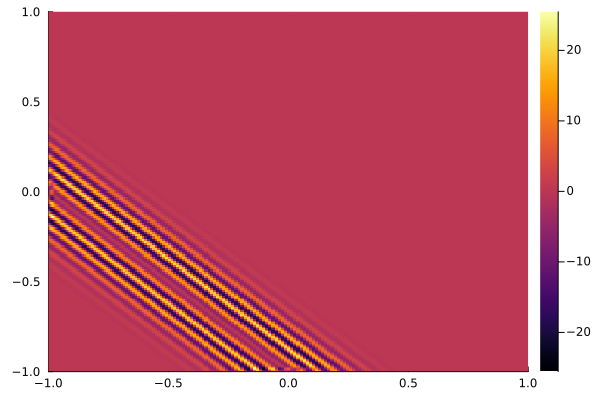

In [248]:
pcont = heatmap(ndg.x, ndg.y, ndg.Q1)#, fill = true)
plot(pcont, format=:png)

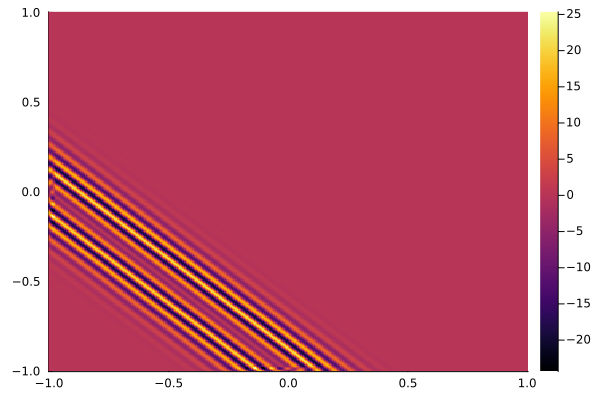

In [445]:
pcont = heatmap(xx,yy, transpose(PP))#, fill = true)
plot(pcont, format=:png)

# Conclusion

This finishes Chapter 5! Probably the hardest so far. Next, we will skip all the way to Chapter 8 and continue with 1D, because 2D and 3D gets into more complex geometries that requires more time than tutorials like this. 